In [1]:
import warnings
warnings.filterwarnings('ignore')

from IPython.display import display
from IPython.display import HTML
import IPython.core.display as di # Example: di.display_html('<h3>%s:</h3>' % str, raw=True)

# This line will hide code by default when the notebook is exported as HTML
di.display_html('<script>jQuery(function() {if (jQuery("body.notebook_app").length == 0) { jQuery(".input_area").toggle(); jQuery(".prompt").toggle();}});</script>', raw=True)

# This line will add a button to toggle visibility of code blocks, for use with the HTML export version
di.display_html('''<button onclick="jQuery('.input_area').toggle(); jQuery('.prompt').toggle();">Toggle code</button>''', raw=True)

Toggle code

In [2]:
dataset_name = "W19_comb"
df_list = [ "BES_Panel", ]
# df_list = []

In [3]:
%matplotlib inline

import numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
import pickle, os, gc, re

sns.set();
sns.set_palette("colorblind")

from IPython.display import display, display_html, HTML
from IPython.core.debugger import set_trace
# plt.rcParams["axes.grid"] = False

import Jupyter_module_loader
from utility import *
import gaussian_kde

import warnings
warnings.filterwarnings('ignore')

import holoviews as hv
from holoviews import opts

encoding = "ISO-8859-1"

In [4]:
# you should clone this git to a subdirectory called 'BES_analysis_code' (in some directory - I call it BES_analysis - doesn't matter though)
# %matplotlib inline
(BES_code_folder, BES_small_data_files, BES_data_folder,
 BES_output_folder, BES_file_manifest, BES_R_data_files) = setup_directories()

global BES_Panel, BES_numeric, BES_reduced, BES_reduced_with_na, BES_non_numeric
data_subfolder = BES_data_folder + dataset_name + os.sep

(manifest, dataset_filename, dataset_description, dataset_citation,
 dataset_start, dataset_stop, dataset_wave) = get_manifest(dataset_name, BES_file_manifest)

for df in df_list:
    if df=="BES_Panel":
#         globals()[df]  = pd.read_msgpack(data_subfolder + dataset_filename.replace('.dta','.msgpack'))
        globals()[df]  = pd.read_pickle(data_subfolder + dataset_filename.replace('.dta','.zip'),compression='zip')
    else:
        globals()[df]  = pd.read_pickle(data_subfolder + df + '.zip',compression='zip')
#         read_msgpack(data_subfolder + df + '.msgpack' )
        globals()[df].replace(-1,np.nan,inplace=True)
  
(var_type, cat_dictionary, new_old_col_names, old_new_col_names) = get_small_files(data_subfolder, encoding)

# get full set of inferred "cross wave" auth-lib/left-right values and ages
pan_dataset_allr_values = pd.read_csv(BES_small_data_files + "pan_dataset_allr_values"+".csv")
pan_dataset_ages = pd.read_csv( BES_small_data_files + "pan_dataset_ages"+".csv" )

var_type (7911, 14)


In [5]:
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure, show,  output_notebook
from bokeh.layouts import column, row, layout
from bokeh.embed import components
from bokeh.models import HoverTool
from bokeh.models import Span, Label
from bokeh.models import BoxAnnotation
output_notebook()
from datetime import timedelta
from scipy.signal import find_peaks
from bokeh.models import Span
from datetime import datetime
import pytz

Loading BokehJS ...

In [6]:
# BES_Panel = pd.read_pickle("..\\BES_analysis_data\\"+"W19_comb"+os.sep+"BES2019_W19_Panel_v0.1_cleaned.zip",compression='zip')

# Step One: Locate the period of the Major Shift In Sentiment
- Find all the directly-immigration-related sentiment variables

* personal preferences for immigration levels (immigrationLevel|immigSelf|(types)More)
* personal perception of *impact* of immigration (immigEcon|immigCultural|immigContibuteTake|ImmigrantsWelfareState|ukCoopMovement)
* personal expectations about immigration levels/control (effectsEUImmigration|changeImmig|controlImmig)
* perception of parties/(gov/opp) preference/ability to/responsibility for changing/reducing immig/prioritisation of immig
    (immig(parties)/responsibleImmig(parties)/achieveReduceImmig/(party)Priorities_immig)
* preference/perception of immigration priority in EU negotiations (euPriorityBalance|dealPriority|negotiationSpecifics)

* not sure where "benefitsToMigrants" fits in - not really an impact/level/expectation
- but I would expect it to correlate with immigContributeTake/ImmigrantsWelfareState

In [7]:
# wave="W1"

# BES_Panel[wts_for_wave[wave]][BES_Panel[wave.replace("W","wave")]].isnull().sum(), wts_for_wave[wave]

# # 629 missing variables in weights from W8 - W19

# # 643 W7 - heads up to 983


In [6]:
# # %%time
# # Fix up all the datasets we'll be using (make sure all categories correctly/consistently ordered)
# immig_var_stub = ["immigEcon","immigCultural","immigSelf","immigrationLevel","immigContributeTake",
#                   "immigrantsWelfareState","controlImmig","effectsEUImmigration","euPriorityBalance",
#                   "changeImmig","changeImmigLab","govtHandleImmig","labHandleImmig",
#                   "asylumMore","euMore","noneuMore","studentsMore","familiesMore",
#                   "responsibleImmig","achieveReduceImmig",
#                   "conPriorities_immig","labPriorities_immig","ldPriorities_immig","ukipPriorities_immig",
#                   "dealPriority","ukCoopMovement","negotiationSpecifics","benefitsToMigrants","childBenefitsRepatriate"]

# fix_cat_dict = {}
# # not sure about best way to line up "expectation" variables
# fix_cat_dict['changeImmig']=['Getting a lot lower', 'Getting a little lower','Staying about the same',
#                              'Getting a little higher', 'Getting a lot higher',  "Don't know" ]
# fix_cat_dict['effectsEUImmigration'] = ['Much lower', 'Lower', 'About the same', 'Higher', 'Much higher', "Don't know"]
# fix_cat_dict['controlImmig']=['No control at all', 'A little control', 'Some control', 'A lot of control', 'Complete control', "Don't know"]

# # lets try to get every axis pointing in the same "sentiment" direction
# fix_cat_dict['immigEcon']=['Bad for economy','2', '3', '4', '5', '6', 'Good for economy',  "Don't know"]
# fix_cat_dict['immigCultural']=['Undermines cultural life', '2', '3', '4', '5', '6', 'Enriches cultural life', "Don't know" ]
# fix_cat_dict["immig(Self|Con|Lab|TIG|Brexit|Green|UKIP|PC|SNP|LD)W"] = ['Allow many fewer', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'Allow many more', "Don't know"]
# fix_cat_dict['(students|eu|asylum|families|noneu)More'] = ['Many fewer', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'Many more', "Don't know"]
# fix_cat_dict['immigrantsWelfareState'] = ['Strongly agree', 'Agree', 'Neither agree nor disagree', 'Disagree', 'Strongly disagree', "Don't know"]
# fix_cat_dict['immigContributeTake'] = ['Get more than they pay', '2.0', '3.0', '4.0',
#                                        '5.0', '6.0', 'Pay more than they get', "Don't know"]
# fix_cat_dict['euPriorityBalance'] = ['Control immigration', '9', '8', '7', '6', '5', '4', '3', '2', '1', 'Access to the single market', "Don't know"]
# fix_cat_dict['immigrationLevel'] = ['Decreased a lot', 'Decreased a little', 'Left the same as it is now',
#                                     'Increased a little', 'Increased a lot',  "Don't know"]
# fix_cat_dict['ukCoopMovement'] = ["Bad for Britain", "Neither good nor bad for Britain", "Good for Britain", "Don't know"]
# fix_cat_dict['benefitsToMigrants'] = ['Immediately on arrival','After living in GB for a year',
#                                       'After they have worked and paid taxes for at least four years',
#                                       'After they become a British citizen', 'Never', "Don't know"]



# # fix_cat_dict['immigrantsWelfareState'] = ['Strongly disagree', 'Disagree',  'Neither agree nor disagree','Agree', 'Strongly agree',"Don't know", ]
# # mostly dealPrioritImmig, but might be worth setting alongside the other dealPriority variables
# fix_cat_dict['dealPriority'] = ['Not important at all', 'Not very important', 'Somewhat important',
#                                 'Very important', 'Extremely important' , "Don't know"]

# # fix_cat_dict['euPriorityBalance'] = ['Access to the single market', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'Control immigration', "Don't know"]
# fix_cat_dict['(lab|govt)HandleImmig'] = ['Very badly', 'Fairly badly', 'Neither well nor badly', 'Fairly well', 'Very well', "Don't know"]
# fix_cat_dict['responsibleImmig(Conservatives|LibDems|Labour|ScottishGovt|WelshGovt|None|DontKnow)'] = ["No","Yes","Don't know"]
# fix_cat_dict['achieveReduceImmig(Brexit|Con|Grn|LD|Lab|None|PC|SNP|TIG|UKIP)'] = ["No","Yes","Don't know"]

# fix_cat_dict["(con|lab|ld|ukip)Priorities_immig"] = ["No","Yes","Don't know"]
# # my time plotting function assumes variable names won't contain _ - quick hack to circumvent having to change that
# BES_Panel[[x.replace("_i","I") for x in search(BES_Panel,"Priorities_immig").index]] = BES_Panel[[x for x in search(BES_Panel,"Priorities_immig").index]]

# # my time plotting function assumes variable names won't contain _ - quick hack to circumvent having to change that
# BES_Panel[[x.replace("_1","ContinuePayingMoney").replace("_2","AcceptingFoM").replace("_3","AcceptingEUReg").replace("_none","Nothing") for x in search(BES_Panel,"negotiationSpecifics").index]] = BES_Panel[[x for x in search(BES_Panel,"negotiationSpecifics").index]]

# fix_cat_dict["negotiationSpecifics"] = ["No","Yes","Don't know"]

# def cat_2_num_drop_dk(x):
#     if x.dtype.name=='category':
#         return x.replace("Don't know",np.nan).cat.remove_unused_categories().cat.codes.replace(-1,np.nan).astype('UInt16')
#     else:
#         return x

# def fix_cats(fix_cat_dict):
#     for key in fix_cat_dict.keys():
#         BES_Panel[ match(BES_Panel, key ).index ] = BES_Panel[ match(BES_Panel,key ).index ]\
#             .apply( lambda x: x.cat.set_categories( fix_cat_dict[key], ordered =True ) )
    
# fix_cats(fix_cat_dict)

def weighted_mean(x, **kws):
    val, weight = map(np.asarray, zip(*x))
    val, weight = val[~np.isnan(val)],weight[~np.isnan(val)]
#     raise Exception
    return (val * weight).sum() / weight.sum()

def datetime_weighted_mean(x, **kws):
    val, weight = map(np.asarray, zip(*x))
    val = pd.Series(val).apply(lambda x: x.timestamp() if pd.notnull(x) else np.nan)
    mask = (~np.isnan(val))
    val, weight = val[mask],weight[mask]
    result = (val * weight).sum() / np.sum(weight)
#     raise Exception
    result = datetime.fromtimestamp(result,tz=pytz.timezone('GMT')) if pd.notnull(result) else np.nan  # turn back from timestamp
    return result

# max_wave = int(re.match("W(\d+)_",dataset_name).groups()[0])
max_wave = np.max([int(x.replace("wave","")) for x in match(BES_Panel,"wave\d+$").index])
num_to_wave = {x:"W"+str(x) for x in range(1,max_wave+1)}
wts_for_wave = { "W"+str(y):[x for x in BES_Panel.columns.sort_values(ascending=False) if re.match("wt_(new|full)_W"+str(y)+"(_result)?"+"$",x)][0] for y in range(1,max_wave+1) }
# wts_for_wave["W5"] = 'wt_daily_W5'
# wts_for_wave["W8"] = 'wt_daily_W8'
# wts_for_wave["W12"] = 'wt_daily_W12'
# wts_for_wave["W18"] = 'wt_daily_W18'

# dirty hack to deal with missing values in weights
# BES_Panel[list(wts_for_wave.values())] = BES_Panel[list(wts_for_wave.values())].replace(np.nan,1.0)
# feedback from BES folk -> drop these respondents!

# drop_ids = BES_Panel.loc[BES_Panel[wts_for_wave.values()].isnull().all(axis=1)].index
# BES_Panel.drop(drop_ids, inplace=True)

waves = BES_Panel[search(BES_Panel,"wave").index].copy()
wts = BES_Panel[wts_for_wave.values()].isnull().copy()
wts.columns = waves.columns
drop_ids = BES_Panel.loc[((wts*waves).sum(axis=1)>0)].index
BES_Panel.drop(drop_ids, inplace=True)

# still leaves some with misssing

BES_Panel[list(wts_for_wave.values())] = BES_Panel[list(wts_for_wave.values())].replace(np.nan,1.0)

wave_to_date = BES_file_manifest[BES_file_manifest["Only_or_Combined"]=="Only"][["Wave No","Date_Start"]].set_index("Wave No")["Date_Start"]


### CHECK TIMES IN NEW 3 WAVES!

# fix endtimeW3 bug!
BES_Panel.loc[BES_Panel["endtimeW3"]=='1970-01-01 00:00:00',"endtimeW3"] = \
    BES_Panel[BES_Panel["endtimeW3"]=='1970-01-01 00:00:00']["starttimeW3"].values

# this is also suspect - date not unreasonable, but overlaps with a different wave! (3 days between start/end)
# 41222   2015-03-27 18:11:37.047
# Name: starttimeW5, dtype: datetime64[ns]
BES_Panel.loc[BES_Panel["starttimeW5"]=='2015-03-27 18:11:37.047000064',"starttimeW5"] = \
    BES_Panel[BES_Panel["starttimeW5"]=='2015-03-27 18:11:37.047000064']["endtimeW5"].values

# still some overlap between waves 4 and 5

midpoint_dict = {}
startpoint_dict = {}
endpoint_dict = {}
# create correct midpoints (technically we should weight these!)
n = 1
min_sample_size = 100
for wave_no in range(1,max_wave+1):
    wave = "W"+str(wave_no)
#     print(wave)

#     BES_Panel["midpoint"+wave] = pd.qcut(BES_Panel["endtime"+wave]+((BES_Panel["endtime"+wave]-BES_Panel["starttime"+wave])/2),n)
#     date_cats_dict = {BES_Panel["midpoint"+wave].cat.categories[x]:(BES_Panel["midpoint"+wave].cat.categories[x].left+ (BES_Panel["midpoint"+wave].cat.categories[x].right - BES_Panel["midpoint"+wave].cat.categories[x].left)/2).strftime("%Y-%m-%d") for x in range(n)}
#     BES_Panel["midpoint"+wave] = pd.to_datetime(BES_Panel["midpoint"+wave].replace(date_cats_dict))  
    BES_Panel["endpoint"+wave] = pd.to_datetime(BES_Panel["endtime"+wave]).max() 
    BES_Panel["startpoint"+wave] = pd.to_datetime(BES_Panel["starttime"+wave]).min() 
    
    BES_Panel["midtime"+wave] = (BES_Panel["starttime"+wave]+(BES_Panel["endtime"+wave]-BES_Panel["starttime"+wave])/2)
#     BES_Panel["midtime"+wave] = BES_Panel["midtime"+wave].apply(lambda x:x.replace(second=0, microsecond=0, nanosecond=0))
    BES_Panel["midpoint"+wave] = datetime_weighted_mean(zip(BES_Panel["midtime"+wave],BES_Panel[wts_for_wave[wave]]))

    startpoint_dict[wave] = BES_Panel["startpoint"+wave].dropna().values[0]
    endpoint_dict[wave] = BES_Panel["endpoint"+wave].dropna().values[0]
    midpoint_dict[wave] = BES_Panel["midpoint"+wave].dropna().values[0]

In [7]:
colour_list = ["blue","red","purple", "olive","orange","brown", "pink","cyan","grey","green"]

In [8]:
x_axis_label = "Response Date"
y_axis_label = "Responses/day"
plot_width=980
plot_height=600
tools='box_select,pan,xwheel_zoom,box_zoom,reset'
active_drag='pan'
active_scroll='xwheel_zoom'
title = "British Election Study Waves"
p= figure(x_axis_type="datetime", x_axis_label = x_axis_label,
            y_axis_label = y_axis_label,
            plot_width = plot_width, plot_height=plot_height,
            title = title, tools = tools, active_drag = active_drag, active_scroll=active_scroll)
p.title.text_font_size = '48pt'

date_col_dict = {"EE":'green',"GE":'red',"EU":'blue',"OB":'pink',"CL":'purple',"CAMP":'orange',"normal":'grey'}  

date_dict = {"22 May 2014":"EE","7 May 2015":"GE","23 June 2016":"EU",
             "8 June 2017":"GE","23 May 2019":"EE","21 April 2016":"OB",
             "9 October 2014":"CL","12 December 2019":"GE",
             "3 March 2015":"CAMP", "23 April 2017":"CAMP", "6 November 2019":"CAMP","15 April 2016":"CAMP"}

date_duration_dict = {"22 May 2014":1,"7 May 2015":1,"23 June 2016":1,
             "8 June 2017":1,"23 May 2019":1,"21 April 2016":2,
             "9 October 2014":1,"12 December 2019":1,
             "3 March 2015":37, "23 April 2017": 45, "6 November 2019":35,"15 April 2016":68 }
    
#     date_col_dict = {"EE":'green',"GE":'red',"EU":'blue',"OB":'pink',"CL":'purple',"CAMP":'orange'}  

wave_type_dict = dict(zip(["W"+str(x) for x in range(1,max_wave+1)],["normal"]*max_wave))

wave_type_dict["W1"] = "PRECAMP"
wave_type_dict["W4"] = "PRECAMP"
wave_type_dict["W7"] = "PRECAMP"
wave_type_dict["W11"] = "PRECAMP"
# wave_type_dict["W14"] = "PRECAMP"
wave_type_dict["W17"] = "PRECAMP"

wave_type_dict["W2"] = "CAMP"
wave_type_dict["W5"] = "CAMP"
wave_type_dict["W8"] = "CAMP"
wave_type_dict["W12"] = "CAMP"
wave_type_dict["W15"] = "CAMP"
wave_type_dict["W18"] = "CAMP"

wave_type_dict["W3"] = "POSTCAMP"
wave_type_dict["W6"] = "POSTCAMP"
wave_type_dict["W9"] = "POSTCAMP"
wave_type_dict["W13"] = "POSTCAMP"
wave_type_dict["W16"] = "POSTCAMP"
wave_type_dict["W19"] = "POSTCAMP"

wave_colour = { "PRECAMP": "red", "CAMP": "yellow", "POSTCAMP": "green", "normal":"grey" }

for wave in startpoint_dict.keys():

    my_label = Label(x=midpoint_dict[wave], y=200, y_units='screen', text=wave)
    df = BES_Panel[["midtime"+wave,"id"]].set_index("midtime"+wave).resample('1d').count()["id"]
    ind = df.index.values
    ind[0] = startpoint_dict[wave]
#     ind[-1] = endpoint_dict[wave]
    df.index = ind
    p.quad(top=df.values, bottom=0, left=df.index, right=np.append(df.index[1:].values, endpoint_dict[wave] ),
           fill_color="navy", line_color="white", alpha=0.5)

    box_left = startpoint_dict[wave]
    box_right = endpoint_dict[wave]

    box = BoxAnnotation(left=box_left, right=box_right,
                        line_width=1, line_color='black', line_dash='dashed',
                        fill_alpha=0.2, fill_color= wave_colour[wave_type_dict[wave]])
                        #(colour_list+colour_list)[int(wave.replace("W",""))] )
    
    p.add_layout(my_label) 
    p.add_layout(box)
for date in date_dict.keys():       

    if date_dict[date]=="CAMP" or date_dict[date]=="CL" or date_dict[date]=="OB":
        continue
    my_label = Label(x=pd.to_datetime(date), y=400, y_units='screen', text=date_dict[date])
    p.add_layout(my_label) 

    box_left = pd.to_datetime(date)
    box_right = pd.to_datetime(date)+timedelta(days=date_duration_dict[date])

    box = BoxAnnotation(left=box_left, right=box_right,
                        line_width=1, line_color='black', line_dash='dashed',
                        fill_alpha=0.2, fill_color=date_col_dict[date_dict[date]])

    p.add_layout(box)   

show(p)

In [9]:
def time_series(var_name,title,subtract_var=False,retain_var=True,specific_dates=True, specific_suffix_set="([a-zA-Z]*)",
                use_midpoints=False,col_name="party",dk_str="Don't know",max_y_size=10.0,min_waves_included=2,
                max_y_size_dict=None,max_wave=max_wave,use_BES_weights=True):

    whole_wave_dk_average = True
    df=pd.DataFrame()
    df2 =pd.DataFrame()
    df_wts =pd.DataFrame()
    df_dates = pd.DataFrame()
    
    if subtract_var:
        title=title+"\n(where respondents place parties relative to their own preference set at 0.5)"

    wave_list = []
    redist_vars = pd.Series([re.match(var_name+specific_suffix_set+"($|W\d+)",x).groups()[0] for x in BES_Panel.columns\
                             if re.match(var_name+specific_suffix_set+"($|W\d+)",x)]).value_counts()
    redist_vars = redist_vars[redist_vars>=min_waves_included].index

   
    
    for subj in redist_vars:
        for wave in ["W"+str(x) for x in range(1,max_wave+1)]:
            if var_name+subj+wave not in BES_Panel.columns:
                continue
            else:
                wave_list.append(wave)
            if max_y_size_dict:
                max_y_size = max_y_size_dict[subj]
#             df[var_name+"num_"+subj+"_"+wave] = zip(BES_Panel[var_name+subj+wave].replace(dk_str,np.nan).cat.codes.replace(-1,np.nan)/max_y_size,
#                                                  BES_Panel[var_name+subj+wave].apply(lambda x: x==dk_str if pd.notnull(x) else np.nan),
#                                                  BES_Panel[wts_for_wave[wave]]
#                                                    )
            
            df[var_name+"num_"+subj+"_"+wave] = BES_Panel[var_name+subj+wave].replace(dk_str,np.nan).cat.codes.replace(-1,np.nan)/max_y_size

            
            df2[var_name+"dk_"+subj+"_"+wave] = BES_Panel[var_name+subj+wave]==dk_str
            df2[var_name+"dk_"+subj+"_"+wave][BES_Panel[var_name+subj+wave].isnull()] = np.nan

           
            
    for wave in pd.unique(wave_list):        
        df_wts["wt_"+wave] = BES_Panel[wts_for_wave[wave]]
        
        if use_midpoints:
            df_dates["dt_"+wave] = BES_Panel["midpoint"+wave]
        else:
            df_dates["dt_"+wave] = (BES_Panel["starttime"+wave]+(BES_Panel["endtime"+wave]-BES_Panel["starttime"+wave])/2)
#             .apply(lambda x:x.date())

#     set_trace()
#     df_wts = df_wts[df.notnull().any(axis=1)]
#     df = df[df.notnull().any(axis=1)]

    df2.columns = df2.columns.str.split('_', expand=True)
    df2 = df2.stack(dropna=False)\
                .reset_index()\
                .rename(columns={'level_1':"wave"})\
                .rename(columns={'level_0':"id"}) 

    df_wts.columns = df_wts.columns.str.split('_', expand=True)
    df_wts = df_wts.stack(dropna=False)\
                .reset_index()\
                .rename(columns={'level_1':"wave"})\
                .rename(columns={'level_0':"id"}) 

    df_dates.columns = df_dates.columns.str.split('_', expand=True)
    df_dates = df_dates.stack(dropna=False)\
                .reset_index()\
                .rename(columns={'level_1':"wave"})\
                .rename(columns={'level_0':"id"}) 

    df.columns = df.columns.str.split('_', expand=True)
    df = df.stack(dropna=False)\
            .reset_index()\
            .rename(columns={'level_1':"wave"})\
            .rename(columns={'level_0':"id"}) 

    content_columns = [(var_name+"dk",x) for x in redist_vars]
    df["wt"] = df_wts["wt"]
    df[content_columns] = df2[content_columns]
    df["date"] = df_dates["dt"]
    content_columns = [(var_name+"num",x) for x in redist_vars]+[(var_name+"dk",x) for x in redist_vars]
    # only keep rows with content (variable values/dks)

    df = df[df[content_columns].notnull().any(axis=1)]

#     df = df.loc[ df[[x for x in df.columns if var_name+"num" in x]].notnull().any(axis=1) ]
    df.loc[:,"wt"] = df.loc[:,"wt"].fillna(1.0).values
    temp_ind_name = "temp_index"

#     if specific_dates:
#         df["date"] = df[["id","wave"]].merge(right=df_dates,
#                  how="left",left_on=["id","wave"],right_on=["id","wave"])["dt"].values

    df[temp_ind_name] = list(zip(df["wave"],df["wt"],df["date"],df["id"]))
    df = df.set_index(temp_ind_name).drop(["id","wave","wt","date"],axis=1)



    if subtract_var:
        if retain_var:
            focal_vars = [x for x in df.columns if (var_name+"num" in x) and (subtract_var not in x)]
            df[focal_vars] = df[focal_vars].apply(lambda x: x-df[(var_name+"num",  subtract_var)])+0.5
        else:
            focal_vars = [x for x in df.columns if var_name+"num" in x]
            df[focal_vars] = df[focal_vars].apply(lambda x: x-df[(var_name+"num",  subtract_var)])+0.5
            df.drop((var_name+"num",  subtract_var),axis=1,inplace=True)

#     df2["wt"] = df_wts["wt"]

#     df2 = df2.loc[ df2[[x for x in df2.columns if var_name+"dk" in x]].notnull().any(axis=1) ]
#     df2.loc[:,"wt"] = df2.loc[:,"wt"].fillna(1.0).values
#     if specific_dates:
#         df2["date"] = df2[["id","wave"]].merge(right=df_dates,
#                  how="left",left_on=["id","wave"],right_on=["id","wave"])["dt"].values

#     temp_ind_name = "temp_index"
#     df2[temp_ind_name] = list(zip(df2["wave"],df2["wt"],df2["date"]))
#     df2 = df2.set_index(temp_ind_name).drop(["id","wave","wt","date"],axis=1)


    flat_df_num = df.stack().reset_index().rename(columns={'level_1':col_name})

    if specific_dates:
        flat_df_num["wave"] = flat_df_num[temp_ind_name].apply(lambda x:x[0])    
    else:
        flat_df_num["wave"] = flat_df_num[temp_ind_name].apply(lambda x:int(x[0].split("W")[1]))

    flat_df_num["wt"]   = flat_df_num[temp_ind_name].apply(lambda x:x[1])
    flat_df_num["date"] = flat_df_num[temp_ind_name].apply(lambda x:x[2])
    flat_df_num["id"]   = flat_df_num[temp_ind_name].apply(lambda x:x[3])
    
    
    
    flat_df_num.drop(temp_ind_name,axis=1,inplace=True)
    flat_df_num[col_name] = flat_df_num[col_name].astype('category')

    flat_df_num[var_name+"_wts"] = list(zip(flat_df_num[var_name+"num"],flat_df_num["wt"]))
    flat_df_num[var_name+"_dk"] = list(zip(flat_df_num[var_name+"dk"],flat_df_num["wt"]))

    
#     flat_df_dk = df2.stack().reset_index().rename(columns={'level_1':col_name,0:"dk"})
#     if specific_dates:
#         flat_df_dk["wave"] = flat_df_dk[temp_ind_name].apply(lambda x:x[0])    
#     else:
#         flat_df_dk["wave"] = flat_df_dk[temp_ind_name].apply(lambda x:int(x[0].split("W")[1]))

#     flat_df_dk["wt"]   = flat_df_dk[temp_ind_name].apply(lambda x:x[1])
#     flat_df_dk["date"] = flat_df_dk[temp_ind_name].apply(lambda x:x[2])
    
#     flat_df_dk.drop(temp_ind_name,axis=1,inplace=True)
#     flat_df_dk[var_name+"dk"] = flat_df_dk[var_name+"dk"].astype('int')
    
#     if whole_wave_dk_average:
#     # calculating weighted total-wave dk average
#         flat_df_dk = flat_df_dk.groupby(["wave",col_name]).apply(lambda x: (x["wt"]*x[var_name+"dk"]).sum()/x["wt"].sum() ).reset_index().rename(columns={0:"dk"})
#         flat_df_num = flat_df_num.merge(right=flat_df_dk[[col_name,"wave","dk"]],how='left',left_on=[col_name,"wave"],right_on=[col_name,"wave"])        
#     else:
    
#         flat_df_dk["dk"+"_wts"] = list(zip(flat_df_dk[var_name+"dk"],flat_df_num["wt"]))
    

#     flat_df_num = flat_df_num.merge(right=flat_df_dk[[col_name,"wave","dk"]],how='left',left_on=[col_name,"wave"],right_on=[col_name,"wave"])
    if not specific_dates:
        flat_df_num["date"] = flat_df_num["wave"].apply(lambda x: wave_to_date[x])
        flat_df_num["date"] = pd.to_datetime(flat_df_num["wave"] , format="%b-%y")

#     raise Exception
        
    return flat_df_num, df, df2, 

In [10]:
def sample_size(x, **kws):
    global max_sample_size    
    return len(x)/max_sample_size

def between_wave_retention(*args, **kwargs):
    global position_in_var_list
    var_name = kwargs['var_name'][position_in_var_list]
    position_in_var_list = position_in_var_list+1
    color = kwargs['color']
    label = kwargs['label']
    alpha = kwargs['alpha']
    df = BES_Panel[match(BES_Panel,var_name+"($|W\d+)").index].apply(lambda x: x.cat.codes.replace(-1,np.nan)).diff(axis=1).notnull().sum()/match(BES_Panel,var_name+"($|W\d+)")
    waves_present = {"W"+x.split("W")[-1]:BES_Panel["midpointW"+x.split("W")[-1]].dropna().values[0] for x in df.index}    
    df.index = [BES_Panel["midpointW"+x.split("W")[-1]].dropna().values[0] for x in df.index]
    df.drop(df.index[0],inplace=True)
    sns.lineplot(data=df,color=color,label=label,alpha=alpha)

    for wave in waves_present.keys():
        plt.text(x=waves_present[wave],y=0,s=wave, rotation=90, fontsize=12)   
        
def plot_time_series(var_name,specific_suffix_set,title,col_name,col_wrap,treatment,max_wave,use_BES_weights=True):
    dk_str="Don't know"
    lowest_alpha=0.3
    low_alpha=0.5    
    date_dict = {"22 May 2014":"EE","7 May 2015":"GE","23 June 2016":"EU","8 June 2017":"GE","23 May 2019":"EE"}
    date_col_dict = {"EE":'green',"GE":'red',"EU":'blue'}    
#     print(1)
    max_y_size_dict = {x: len(BES_Panel[match(BES_Panel,var_name+x+"($|W\d+)").index[0]].cat.remove_categories(dk_str).cat.categories)-1 for x in specific_suffix_set.replace("(","").replace(")","").split("|") }
    # max_y_size=len(BES_Panel[ match(BES_Panel,var_name+specific_suffix_set+"($|W\d+)").index[0] ].cat.remove_categories(dk_str).cat.categories)-1,
    flat_df_num, df, df2, = time_series(var_name,title,specific_suffix_set=specific_suffix_set,col_name="party",
                                max_y_size_dict = max_y_size_dict,
                                dk_str=dk_str,min_waves_included=2,use_midpoints=False,
                                max_wave=max_wave,use_BES_weights=use_BES_weights)
#     print(2)
#     raise Exception
    flat_df_num["wave_midpoint"] = flat_df_num["wave"].apply( lambda x: midpoint_dict[x] )
    flat_df_num["wave_startpoint"] = flat_df_num["wave"].apply( lambda x: startpoint_dict[x] )
    flat_df_num["wave_endpoint"] = flat_df_num["wave"].apply( lambda x: endpoint_dict[x] )
    
    
#     print(3)
    global max_sample_size
    global position_in_var_list
    position_in_var_list=0
#     max_sample_size = flat_df_num["dk"].value_counts().max()
    max_sample_size = flat_df_num.groupby(["party","wave"]).apply(lambda x: len(x)).max()
#     print(4)

    g = sns.FacetGrid(data=flat_df_num, col=col_name, col_wrap=col_wrap, ylim=(0.0, 1.0), legend_out=False, height=height);
    
#     raise Exception
#     print(5)    
#     raise Exception    
    if use_BES_weights:
        g.map(sns.lineplot, "wave_midpoint",var_name+"_wts", ci=None, n_boot=1, label="Mean answer", estimator=weighted_mean,
              err_style="bars", markers=True, dashes=False);
        g.map(sns.lineplot, "wave_midpoint",var_name+"_dk", color='r', ci=None,n_boot=1,estimator=weighted_mean,
              err_style="bars", label="DK fraction",markers=True, dashes=False, alpha=low_alpha);        
    else:
        g.map(sns.lineplot, "wave_midpoint",var_name+"num", label="Mean answer",
              err_style="bars", markers=True, dashes=False);
        g.map(sns.lineplot, "wave_midpoint",var_name+"dk", color='r',
              err_style="bars", label="DK fraction",markers=True, dashes=False, alpha=low_alpha);        
    

#     print(7)            
    g.map(sns.lineplot, "wave_midpoint","wave", color='g', estimator=sample_size,ci=None,
          label="Sample Size\n(% of max: "+str(max_sample_size)+")",markers=True, dashes=False, alpha=low_alpha);
#     print(8)                
    g.map(between_wave_retention, "wave_midpoint","wave", color='k', var_name=[var_name+x for x in g.col_names],
          label="Retention",markers=True, dashes=False, alpha=low_alpha);
#     print(9)                

    for date in date_dict.keys():
        if flat_df_num["wave_midpoint"].min()<pd.to_datetime(date) and flat_df_num["wave_midpoint"].max()>pd.to_datetime(date):
            g.map(plt.axvline, x=pd.to_datetime(date), ls='--', c=date_col_dict[date_dict[date]], linewidth=1,
                  alpha=lowest_alpha, label=date_dict[date] )
#     print(10)              
    g.map(plt.axhline, y=0.5, ls='-.', c='grey',linewidth=1, alpha=lowest_alpha)

    g.add_legend().set_ylabels("").set_titles(col_template="{col_name}")
    g.fig.suptitle(title, y=1.0+0.03*len(title.split("\n")));
    [plt.setp(ax.get_xticklabels(), rotation=45) for ax in g.axes.flat]

    output_subfolder = create_subdir(BES_output_folder, treatment)
    g.savefig(output_subfolder +clean_filename(var_name +specific_suffix_set)+ ".png", bbox_inches='tight')
    return flat_df_num

In [11]:


# def rolling_av(party, var_name):

#     df_rolling = flat_df_num[flat_df_num["party"]==party].sort_values(by='date').copy().set_index('date')
# # df_rolling = df_rolling["immignum"].rolling(400,center=True).mean()
#     df_rolling = df_rolling[var_name].dropna().rolling(500,center=True,win_type='blackmanharris').mean()
# # win_type='gaussian').sum(std=3)
# # df_rolling = df_rolling["immignum"].rolling('1h',min_periods=10).mean()
#     return df_rolling

def weighted_mean_for_rolling(processed_dataframe_windowed):
    return np.average(a=processed_dataframe_windowed,weights=processed_dataframe_windowed.index)

def rolling_av_exerimental( party, var_name, win_type='blackmanharris',window_size=500 ):
    
    df_rolling = flat_df_num[flat_df_num["party"]==party].sort_values(by='date').copy()
    min_sample_size=200
    temp_dates = pd.qcut( df_rolling["date"], 
            int(np.floor(df_rolling["date"].notnull().sum()/(min_sample_size))) ).apply(lambda x: x.left+(x.right-x.left)/2)

    return df_rolling.groupby(temp_dates)[var_name].agg( lambda x: weighted_mean(x) )

def rolling_av( party, var_name, win_type='blackmanharris',window_size=250 ):

    df_rolling = flat_df_num[flat_df_num["party"]==party].sort_values(by='date').copy()
    fmt = "%Y-%m-%d:%H"

    # slow!
    if win_type=="BES":
        
        # this is a really dumb way to get the right date index!
        
        date_ind = df_rolling.set_index("date")[var_name].dropna().rolling(window_size,
            center=True).mean().index
#         print(date_ind.shape)
        #df_rolling["date"].copy().values
#         df_rolling.index = flat_df_num[flat_df_num["party"]==party].sort_values(by='date').copy()["date"].values
#         raise Exception
        df_rolling = df_rolling.set_index("wt")[[var_name,'date']].dropna().rolling(window_size,
            on='date',center=True)[var_name].apply(weighted_mean_for_rolling, raw=False)
#         print(df_rolling.shape)
        df_rolling.index = date_ind
#         flat_df_num[flat_df_num["party"]==party].sort_values(by='date').copy()["date"].values
#         return temp
    else:
        df_rolling = df_rolling.set_index("date")[var_name].dropna().rolling(window_size,center=True,win_type=win_type).mean()       


    df_rolling.index = [x.strftime(fmt) for x in df_rolling.index]
    df_rolling.reset_index().groupby('index').mean()
    df_rolling = df_rolling.reset_index().groupby('index').mean().dropna()
    df_rolling.index = [pd.to_datetime(x,format=fmt) for x in df_rolling.index]
    df_rolling.index.name='date'
    return df_rolling[var_name]
    

def date_fraction(x,df_temp):
    
    floor_x = int( np.floor(x) )
    return df_temp.index[floor_x]+(x-floor_x)*(df_temp.index[floor_x+1]-df_temp.index[floor_x])


def detect_peaks(df_rolling,prominence,width):

    df_temp = df_rolling.copy().dropna()
    peaks, properties = find_peaks(df_temp, prominence=prominence, width=width)
    properties["prominences"], properties["widths"]

    x= df_temp.index[peaks]
    y= df_temp[peaks].values

    outliers = pd.DataFrame(properties)
    outliers.index = x

    outliers["left_ips"]  = outliers["left_ips"].apply(lambda x: date_fraction(x,df_temp))
    outliers["right_ips"] = outliers["right_ips"].apply(lambda x: date_fraction(x,df_temp))

    aggregate_to_the_hour_fmt = "%Y-%m-%d:%H"
    aggregate_to_the_day_fmt = "%Y-%m-%d"
    fmt = aggregate_to_the_hour_fmt

    outliers["right_ips"] = outliers["right_ips"].apply(lambda x:pd.to_datetime(x.strftime(fmt),format=fmt) if pd.notnull(x) else np.nan)
    outliers["left_ips"] = outliers["left_ips"].apply(lambda x:pd.to_datetime(x.strftime(fmt),format=fmt) if pd.notnull(x) else np.nan)

    outliers.index = outliers.reset_index()["date"].apply(lambda x:pd.to_datetime(x.strftime(fmt),format=fmt) if pd.notnull(x) else np.nan)
    outliers = outliers.rename(columns = {"left_ips":"start","right_ips":"stop"})

    return x,y,outliers

def get_bokeh_source(flat_df_num,min_sample_size=100,var_name=""):

    flat_df_bokeh = flat_df_num.copy()

    # aggregate dates to the level you wish
    aggregate_to_the_hour_fmt = "%Y-%m-%d:%H"
    aggregate_to_the_day_fmt = "%Y-%m-%d"
    fmt = aggregate_to_the_day_fmt
    flat_df_bokeh["date"] = pd.to_datetime(flat_df_bokeh["date"])
    flat_df_bokeh["shortdate"] = pd.to_datetime(flat_df_bokeh["date"].apply(lambda x:x.strftime(fmt) if pd.notnull(x) else np.nan),
                                        format=fmt)

    flat_df_bokeh["date"] = list(zip(flat_df_bokeh["date"].apply(lambda x: x.timestamp() if pd.notnull(x) else np.nan),
                                     flat_df_num["wt"])) # turn into numeric timestamp
    
    df = flat_df_bokeh.groupby(['shortdate','party'])["date",var_name+"_wts",var_name+"_dk"].agg( lambda x: weighted_mean(x) ).reset_index()
    df["date"] = df["date"].apply(lambda x: datetime.fromtimestamp(x,tz=pytz.timezone('GMT')) if pd.notnull(x) else np.nan  ) # turn back from timestamp
    
    df["N"] = flat_df_bokeh.groupby(['shortdate','party']).count().reset_index()[var_name+"num"]
    df["wt_mean"] = flat_df_bokeh.groupby(['shortdate','party']).mean().reset_index()["wt"]*100/2 # "natural" position at 50%
    df["wt_std"] = flat_df_bokeh.groupby(['shortdate','party']).std().reset_index()["wt"]*100/3
    df["dk"] = df[var_name+"_dk"]*100 # % less confusing than fraction
    df["stdev"] = flat_df_bokeh.groupby(['shortdate','party'])[var_name+"num"].std().reset_index()[var_name+"num"]
    df = df[ df["N"]>=min_sample_size ]
    # plot in bokeh so we can explore!
    df.index = df["date"]
    df = df.rename(columns={var_name+"_wts":var_name+"num"}) # ,"shortdate":"date"
    df = df.pivot(index = "date",columns="party", values=[var_name+'num', 'dk', 'N', 'stdev','wt_mean','wt_std'])
    df.columns = ["_".join(x).strip("_") for x in df.columns]
    df = df.reset_index()
    party_list = flat_df_bokeh["party"].unique()
    
    return df,party_list



def bokeh_time(dtstr):
#     return pd.to_datetime(dtstr).value / 1e6
      return pd.to_datetime(dtstr).timestamp() * 1000

def bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict,var_name,x='date',min_sample_size=0,
                          plot_width=490,plot_height=300,dk=True,wts_charts=False,
                          tools='box_select,pan,xwheel_zoom,box_zoom,reset',active_drag='pan',active_scroll='xwheel_zoom',
                          prominence=.15,width=20,rolling_win_type = 'blackmanharris',window_size=250):


    y_axis_label_dk = "&tri=daily-mean-wt/squ=daily-std-wt"
    wave_gap_days_max =2
    lowest_alpha=0.3
    low_alpha=0.5    
    date_dict = {"22 May 2014":"EE","7 May 2015":"GE","23 June 2016":"EU",
                 "8 June 2017":"GE","23 May 2019":"EE","21 April 2016":"OB",
                 "9 October 2014":"CL","12 December 2019":"GE",
                 "3 March 2015":"CAMP", "23 April 2017":"CAMP", "6 November 2019":"CAMP","15 April 2016":"CAMP"}
    date_duration_dict = {"22 May 2014":1,"7 May 2015":1,"23 June 2016":1,
                 "8 June 2017":1,"23 May 2019":1,"21 April 2016":2,
                 "9 October 2014":1,"12 December 2019":1,
                 "3 March 2015":37, "23 April 2017": 45, "6 November 2019":35,"15 April 2016":68 }
    
    date_col_dict = {"EE":'green',"GE":'red',"EU":'blue',"OB":'pink',"CL":'purple',"CAMP":'orange'}        
    
    df,party_list =  get_bokeh_source(flat_df_num, min_sample_size=min_sample_size, var_name=var_name)
    party_list = list( color_dict.keys() )    
    for party in party_list:
        df["scaled_N_"+party] = df["N_"+party].apply(lambda x: np.log2(x+1))/2
    source = ColumnDataSource( df )    


    p = {}
    p_dk = {}
    tool_dict = {}
    outlier_dict = {}
#     rolling_win_type = 'BES'

    
    

    for party in party_list:

        title = title_dict[party]
        color = color_dict[party]
        y = var_name+'num_'+party    

        tool_dict[party]=\
            HoverTool(names=['daily_aggregates'],tooltips = [
                      ('Date','@date{%d/%m/%y}'),
            #                               ('Date','@wave'),
                      ('Mean','@'+var_name+'num_'+party),
                      ('N','@N_'+party),
                      ("SD",'@stdev_'+party),
                      ("DK%",'@dk_'+party),
                     ],
                formatters={'date': 'datetime'},
                # display a tooltip whenever the cursor is vertically in line with a glyph
#                 mode='vline'
                     )


        p[party]= figure(x_axis_type="datetime", x_axis_label = x_axis_label,
                    y_axis_label = y_axis_label,
                    plot_width = plot_width, plot_height=plot_height,
                    title = title, tools = tools, active_drag = active_drag, active_scroll=active_scroll)
        p[party].title.text_font_size = '8pt'

        df_rolling = rolling_av( party, var_name+"num" ,win_type=rolling_win_type,window_size=window_size )
        inferred_wave_gaps = (df_rolling.reset_index()["date"].diff()>timedelta(days=wave_gap_days_max)).astype('int').cumsum()

        for inf_wave in range(0,inferred_wave_gaps.max()+1):   
            rolling_source = ColumnDataSource(pd.DataFrame(df_rolling[df_rolling.index[inferred_wave_gaps==inf_wave]]))
            p[party].line(x,var_name+"num", source=rolling_source, color=color)


        x_out,y_out,outliers = detect_peaks(df_rolling,prominence,width)
        p[party].x(x_out,y_out,color = 'green',size=20, alpha=0.5)

        p[party].circle(x,y, source=source, color=color,name='daily_aggregates', size='scaled_N_'+party,
                        fill_alpha=0.0,line_width=1)
        p[party].add_tools(tool_dict[party])
        outliers.name = party
        outlier_dict[party] = outliers

         
                             

        if dk:
            df_rolling = rolling_av( party, var_name+"dk",win_type=rolling_win_type,window_size=window_size )*100

            p_dk[party]= figure(x_axis_type="datetime",x_axis_label = x_axis_label,
                            y_axis_label=y_axis_label_dk,
                            plot_width = plot_width, plot_height=plot_height,
                            title="".join(title.split(" (")[:-1]+[" (% Don't know)"]),
                            tools=tools, active_drag=active_drag, active_scroll=active_scroll)
            p_dk[party].title.text_font_size = '8pt'

            p_dk[party].circle('date', 'dk_'+party, source=source, color=color, name='daily_aggregates',
                                size='scaled_N_'+party, fill_alpha=0.0,line_width=1)
            if wts_charts:
                p_dk[party].triangle('date', 'wt_mean_'+party, source=source, color=color, 
                                    size='scaled_N_'+party, fill_alpha=0.0,line_width=1)    
                p_dk[party].square('date', 'wt_std_'+party, source=source, color=color, 
                                    size='scaled_N_'+party, fill_alpha=0.0,line_width=1) 
            
            p_dk[party].add_tools( tool_dict[party] )

            inferred_wave_gaps = (df_rolling.reset_index()["date"].diff()>timedelta(days=wave_gap_days_max)).astype('int').cumsum()
            for inf_wave in range(0,inferred_wave_gaps.max()+1):   
                rolling_source = ColumnDataSource(pd.DataFrame(df_rolling[df_rolling.index[inferred_wave_gaps==inf_wave]]))
                p_dk[party].line(x,var_name+"dk", source=rolling_source, color=color)

            x_out,y_out,outliers = detect_peaks(df_rolling,prominence*100,width)
            p_dk[party].x(x_out,y_out,color = 'green',size=20, alpha=0.5)
   
        for date in date_dict.keys():       
            
            if flat_df_num["wave_startpoint"].min()<pd.to_datetime(date) and flat_df_num["wave_endpoint"].max()>pd.to_datetime(date):
                
                my_label = Label(x=pd.to_datetime(date), y=200 + (date_duration_dict[date]>2)*40,
                                 y_units='screen', text=date_dict[date])
                p[party].add_layout(my_label) 
            
                box_left = pd.to_datetime(date)
                box_right = pd.to_datetime(date)+timedelta(days=date_duration_dict[date])

                box = BoxAnnotation(left=box_left, right=box_right,
                                    line_width=1, line_color='black', line_dash='dashed',
                                    fill_alpha=0.2, fill_color=date_col_dict[date_dict[date]])

                p[party].add_layout(box)   
                if dk:
                    p_dk[party].add_layout(my_label) 
                    p_dk[party].add_layout(box) 

    for pno in range(0,len(party_list)):
        for pno2 in range(0,len(party_list)):
            if pno==pno2:
                continue
            p[party_list[pno]].x_range = p[party_list[pno2]].x_range
            p[party_list[pno2]].x_range = p[party_list[pno]].x_range

            if dk:
                p[party_list[pno2]].x_range = p_dk[party_list[pno2]].x_range
                p_dk[party_list[pno]].x_range = p_dk[party_list[pno2]].x_range

    if len(party_list)>1:
        p[party_list[1]].x_range = p[party_list[0]].x_range                
                
    if dk:
        p[party_list[0]].x_range = p_dk[party_list[0]].x_range
        lay = layout( [[y for y in x] for x in list(zip(p.values(),p_dk.values()))] )
    else:
        lay = layout( list(p.values()) )



    show(lay)

    for party in party_list:
        print(party)
        display(outlier_dict[party])
        
    return df,df_rolling

In [12]:
wave_to_date[17] = "Nov-19"
wave_to_date[18] = "Nov-19"
wave_to_date[19] = "Dec-19"

In [13]:
use_BES_weights = True
rolling_win_type = "BES"

In [17]:
use_BES_weights = False
rolling_win_type = 'blackmanharris'


# (1) immgEcon, immigCultural
very low, consistent DKs
sample size high (big boost in last wave is completely new people, so retention takes a dive)
they start in almost the same place, but immigEcon moves more (makes me wonder what happened before 2014 - always in lockstep?)

only a pity they didn't cover this in W9 right after the euref
still, notable that the W7->W8 (pre-campaign -> campaign) shift is completely in line with the W8->W10 shift
again, kind of a shame we don't see W5/W6

sharpest shift W7/W8 -> W10/W11

Wall time: 19min 45s


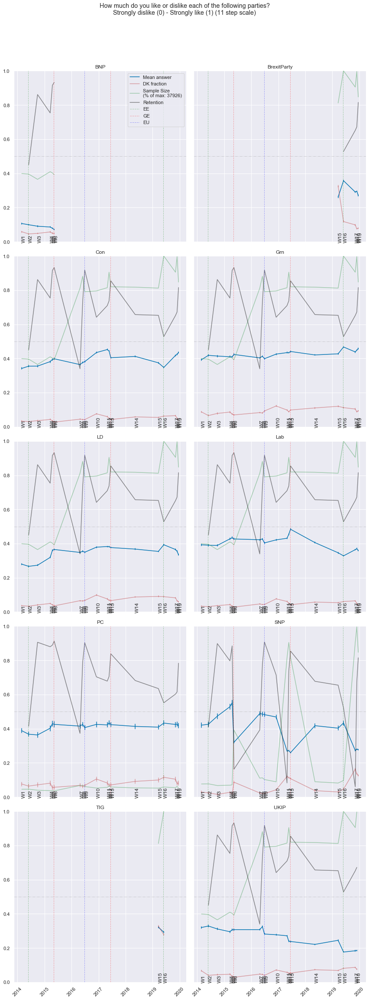

In [24]:
%%time
var_name = "like"
title= "\n".join(["How much do you like or dislike each of the following parties?",
                  "Strongly dislike (0) - Strongly like (1) (11 step scale)"])
specific_suffix_set = "(Con|Lab|LD|SNP|PC|UKIP|Grn|TIG|BNP|BrexitParty)"
# 
col_wrap = 2
height   = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)
                               #,use_BES_weights=True)

In [27]:
specific_suffix_set = "(Con|Lab|LD|SNP|PC|UKIP|Grn|TIG|BNP|BrexitParty)"

In [28]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["How much do you like (1) or dislike (0) each of the following parties? "+"("+x+")?" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,
                    prominence=prominence,width=width, rolling_win_type=rolling_win_type)
#, rolling_win_type="BES")

Con


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-06-25 08:00:00,0.152086,400,1117,23.471899,0.353462,2014-06-24 10:00:00,2014-06-25 09:00:00
2014-10-05 09:00:00,0.181034,400,1697,56.774556,0.357830,2014-10-03 16:00:00,2014-10-06 10:00:00
2015-04-16 14:00:00,0.229025,400,5038,35.521266,0.360503,2015-04-16 00:00:00,2015-04-17 13:00:00
2015-05-14 08:00:00,0.170931,3125,5038,26.773059,0.381573,2015-05-13 14:00:00,2015-05-14 17:00:00
2017-05-08 03:00:00,0.274584,400,7975,69.703594,0.397866,2017-05-07 11:00:00,2017-05-10 09:00:00
2017-05-23 17:00:00,0.154804,6289,6357,20.857697,0.424321,2017-05-23 09:00:00,2017-05-24 06:00:00


Lab


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-02-23 19:00:00,0.152256,17,229,45.955686,0.409873,2014-02-23 15:00:00,2014-02-25 15:00:00
2014-05-31 20:00:00,0.171165,555,1452,32.016673,0.400295,2014-05-31 07:00:00,2014-06-01 15:00:00
2014-10-13 10:00:00,0.164203,555,1702,100.031307,0.418898,2014-10-12 08:00:00,2014-10-16 21:00:00
2015-03-29 19:00:00,0.236921,555,5297,102.611101,0.430963,2015-03-26 06:00:00,2015-03-30 16:00:00
2016-04-21 17:00:00,0.189379,3555,5297,44.223397,0.425776,2016-04-21 10:00:00,2016-04-23 11:00:00
2017-04-30 22:00:00,0.191312,5297,6038,23.554753,0.459552,2017-04-30 14:00:00,2017-05-01 14:00:00
2017-06-07 06:00:00,0.154576,6038,6685,62.204794,0.471054,2017-06-04 17:00:00,2017-06-07 08:00:00
2017-06-19 16:00:00,0.164385,6835,8002,42.620631,0.503310,2017-06-18 17:00:00,2017-06-20 12:00:00
2018-05-13 08:00:00,0.217217,7132,8002,32.883733,0.418100,2018-05-12 18:00:00,2018-05-14 02:00:00


LD


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2015-05-16 18:00:00,0.154515,626,3465,25.744633,0.353655,2015-05-16 13:00:00,2015-05-17 16:00:00
2016-04-22 16:00:00,0.159020,626,3704,43.384498,0.351528,2016-04-21 08:00:00,2016-04-23 08:00:00
2016-05-02 18:00:00,0.184970,626,5012,73.931812,0.342727,2016-04-30 01:00:00,2016-05-03 03:00:00
2017-06-14 05:00:00,0.160245,6697,7564,33.478719,0.370754,2017-06-14 03:00:00,2017-06-15 12:00:00


SNP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-05-23 16:00:00,0.180737,79,460,111.545074,0.451670,2014-03-05 15:00:00,2014-05-24 10:00:00
2015-03-25 09:00:00,0.403090,79,5569,103.223999,0.508069,2015-03-24 16:00:00,2015-03-30 17:00:00
2015-04-25 11:00:00,0.150420,1639,5569,162.071022,0.530198,2015-04-20 19:00:00,2015-04-30 00:00:00
2016-04-15 21:00:00,0.159614,2298,2857,27.642514,0.471607,2016-04-14 19:00:00,2016-04-15 23:00:00
2016-04-30 15:00:00,0.163576,2298,3134,42.386219,0.485032,2016-04-29 20:00:00,2016-05-01 17:00:00
2016-05-26 12:00:00,0.171511,2298,3980,116.715926,0.489287,2016-05-21 15:00:00,2016-05-28 13:00:00
2016-06-25 23:00:00,0.341854,2298,5569,20.708245,0.429930,2016-06-25 15:00:00,2016-06-26 12:00:00
2018-05-14 23:00:00,0.206213,5569,6231,22.148740,0.424389,2018-05-14 11:00:00,2018-05-15 10:00:00
2019-03-20 20:00:00,0.196025,5569,6556,36.476566,0.437604,2019-03-19 22:00:00,2019-03-21 13:00:00


PC


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2015-05-13 16:00:00,0.173299,636,6516,48.536729,0.429882,2015-05-12 12:00:00,2015-05-14 21:00:00
2017-04-30 12:00:00,0.162417,3187,6516,35.958761,0.428723,2017-04-30 06:00:00,2017-05-01 23:00:00


UKIP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-03-01 20:00:00,0.165487,1,8092,35.324539,0.348492,2014-02-28 21:00:00,2014-03-02 09:00:00
2014-05-29 14:00:00,0.193177,390,1028,25.508620,0.313703,2014-05-29 09:00:00,2014-05-30 10:00:00
2014-10-11 18:00:00,0.211247,390,8092,60.689498,0.320874,2014-10-09 11:00:00,2014-10-12 10:00:00
2016-05-18 15:00:00,0.150883,3582,4312,25.546162,0.323384,2016-05-18 06:00:00,2016-05-19 08:00:00
2019-03-12 12:00:00,0.151735,6898,7435,39.256113,0.235730,2018-05-20 08:00:00,2019-03-12 15:00:00


Grn


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-10-14 08:00:00,0.229465,251,4979,67.957527,0.440509,2014-10-12 10:00:00,2014-10-15 15:00:00
2016-04-22 10:00:00,0.198657,3526,4979,38.277559,0.431518,2016-04-21 13:00:00,2016-04-23 08:00:00
2016-05-03 21:00:00,0.161508,3626,3960,20.028361,0.418480,2016-05-03 12:00:00,2016-05-04 08:00:00
2017-05-01 04:00:00,0.166974,4979,5989,25.907213,0.444659,2017-04-30 15:00:00,2017-05-01 17:00:00


TIG


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


BNP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


BrexitParty


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-06-08 05:00:00,0.264030,283,2039,22.155064,0.327518,2019-06-07 19:00:00,2019-06-08 17:00:00
2019-06-11 11:00:00,0.153024,785,2039,24.495339,0.335315,2019-06-10 15:00:00,2019-06-11 15:00:00


Wall time: 4min 27s


# immigEcon

### DEFINITE IMPACT
* 2014-10-13: Clacton by-election on 10th - Douglas Carswell elected as UKIP MP
* 2014-03-04: Something is definitiely happening around the 3/3/2014 ... the impact is pretty sustained. I just don't know what
    - https://www.dailymail.co.uk/news/article-2571144/Home-Secretary-Theresa-May-hits-Cabinet-colleague-Vince-Cable-celebrating-huge-rise-immigration.html
    - https://www.dailymail.co.uk/news/article-2569103/Net-migration-soars-212-000-year-despite-Camerons-tough-talk-cutting-number-tens-thousands.html
* 2016-04-21 22:00:00: Obama telegraph op-en and response by Johnson    

### UNCLEAR

* 2017-05-03 15:00:00: https://en.wikipedia.org/wiki/Portal:Current_events/May_2017 (some 2017GE campaign related stuff) - not convincing
* 2019-03-26 12:00:00: https://www.telegraph.co.uk/news/2019/03/24/pictures-day-24-march-2019/former-ukip-leader-nigel-farage-addresses-marchers-top-bus-start/ - March to Leave/People's Vote March
* 2015-03-28 11:00:00: Germanwings Flight 9525 -> UK GE announced??
* 2014-06-25: Eh - phonehacking? UKIP had a good showing in a byelection a week before?


# I don't buy any of the extra points that show up in immigCultural





In [34]:
np.unique([re.match("like(.*)W\d+",x).groups()[0] for x in match(BES_Panel,"like.*W\d+").index])

array(['AlanJohnson', 'Allen', 'BNP', 'Bartley', 'Batten', 'Bennett',
       'Berger', 'Berry', 'Blair', 'Boris', 'BrexitParty', 'Cable',
       'Cameron', 'CandA', 'CandB', 'Clegg', 'Con', 'Corbyn', 'DUP',
       'Davey', 'Davidson', 'Davis', 'Farage', 'Farron', 'Gove', 'Grn',
       'Harvie', 'Hunt', 'Jarvis', 'Javid', 'LD', 'Lab', 'Leonard',
       'LongBailey', 'Lucas', 'May', 'McDonnell', 'Miliband', 'Mogg',
       'Moran', 'Nuttall', 'Osborne', 'PC', 'Phillips', 'Price', 'Rayner',
       'Rennie', 'Rudd', 'SEvans', 'SNP', 'SNPExtra', 'Salmond', 'Soubry',
       'Starmer', 'Sturgeon', 'Swinson', 'TIG', 'UKIP', 'Umunna',
       'Watson', 'Wood', 'lyBrexit'], dtype='<U11')

In [35]:
"|".join(['AlanJohnson', 'Allen', 'Bartley', 'Batten', 'Bennett',
       'Berger', 'Berry', 'Blair', 'Boris', 'Cable',
       'Cameron', 'Clegg', 'Corbyn', 
       'Davey', 'Davidson', 'Davis', 'Farage', 'Farron', 'Gove',
       'Harvie', 'Hunt', 'Jarvis', 'Javid', 'Leonard',
       'LongBailey', 'Lucas', 'May', 'McDonnell', 'Miliband', 'Mogg',
       'Moran', 'Nuttall', 'Osborne', 'Phillips', 'Price', 'Rayner',
       'Rennie', 'Rudd', 'SEvans', 'Salmond', 'Soubry',
       'Starmer', 'Sturgeon', 'Swinson', 'Umunna',
       'Watson', 'Wood',])

'AlanJohnson|Allen|Bartley|Batten|Bennett|Berger|Berry|Blair|Boris|Cable|Cameron|Clegg|Corbyn|Davey|Davidson|Davis|Farage|Farron|Gove|Harvie|Hunt|Jarvis|Javid|Leonard|LongBailey|Lucas|May|McDonnell|Miliband|Mogg|Moran|Nuttall|Osborne|Phillips|Price|Rayner|Rennie|Rudd|SEvans|Salmond|Soubry|Starmer|Sturgeon|Swinson|Umunna|Watson|Wood'

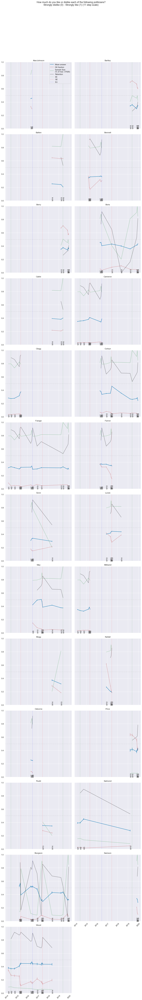

In [39]:
# %%time
var_name = "like"
title= "\n".join(["How much do you like or dislike each of the following politicians?",
                  "Strongly dislike (0) - Strongly like (1) (11 step scale)"])
specific_suffix_set = "(AlanJohnson|Bartley|Batten|Bennett|Berger|Berry|Blair|Boris|Cable|Cameron|Clegg|Corbyn|Davey|Davidson|Davis|Farage|Farron|Gove|Harvie|Hunt|Jarvis|Javid|Leonard|LongBailey|Lucas|May|McDonnell|Miliband|Mogg|Moran|Nuttall|Osborne|Phillips|Price|Rayner|Rennie|Rudd|SEvans|Salmond|Soubry|Starmer|Sturgeon|Swinson|Umunna|Watson|Wood)"
# 
col_wrap = 2
height   = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)
                               #,use_BES_weights=True)

In [48]:
"|".join( flat_df_num["party"].cat.categories )

'AlanJohnson|Bartley|Batten|Bennett|Berry|Boris|Cable|Cameron|Clegg|Corbyn|Farage|Farron|Gove|Lucas|May|Miliband|Mogg|Nuttall|Osborne|Price|Rudd|Salmond|Sturgeon|Swinson|Wood'

In [50]:
specific_suffix_set = "(AlanJohnson|Bartley|Batten|Bennett|Berry|Boris|Cable|Cameron|Clegg|Corbyn|Farage|Farron|Gove|Lucas|May|Miliband|Mogg|Nuttall|Osborne|Price|Rudd|Salmond|Sturgeon|Swinson|Wood)"

In [51]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["How much do you like (1) or dislike (0) each of the following politicians? "+"("+x+")?" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,
                    prominence=prominence,width=width, rolling_win_type=rolling_win_type)
#, rolling_win_type="BES")

AlanJohnson


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Bartley


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-06-08 12:00:00,0.171323,78,810,47.501651,0.36176,2019-06-08 01:00:00,2019-06-10 10:00:00


Batten


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-03-24 12:00:00,0.157248,606,1080,45.420212,0.259095,2019-03-24 08:00:00,2019-03-26 09:00:00


Bennett


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2015-03-28 23:00:00,0.162619,26,822,42.033491,0.359098,2015-03-28 18:00:00,2015-03-30 16:00:00
2016-04-21 22:00:00,0.171883,26,2031,42.505684,0.368557,2016-04-21 09:00:00,2016-04-23 08:00:00


Berry


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-06-12 14:00:00,0.171604,16,939,35.05005,0.361493,2019-06-11 13:00:00,2019-06-13 07:00:00


Boris


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-05-13 22:00:00,0.185923,171,2866,40.858082,0.460006,2016-05-13 17:00:00,2016-05-15 10:00:00
2017-06-10 18:00:00,0.204609,1717,2866,27.482948,0.397948,2016-12-02 18:00:00,2017-06-11 19:00:00


Cable


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Cameron


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-06-03 11:00:00,0.160854,338,812,25.181520,0.331732,2014-06-02 13:00:00,2014-06-03 16:00:00
2014-06-23 16:00:00,0.180931,338,1819,49.757292,0.366789,2014-06-19 12:00:00,2014-06-23 18:00:00
2015-04-19 08:00:00,0.245645,338,4965,23.489706,0.375765,2015-04-18 17:00:00,2015-04-19 17:00:00
2015-05-14 06:00:00,0.153517,3285,4965,22.030692,0.396606,2015-05-13 23:00:00,2015-05-14 21:00:00


Clegg


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Corbyn


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 07:00:00,0.257225,37,1835,39.409623,0.434994,2016-04-21 11:00:00,2016-04-23 07:00:00
2017-06-20 21:00:00,0.317301,1835,5507,99.283933,0.410576,2017-06-18 15:00:00,2017-06-22 19:00:00
2018-05-13 08:00:00,0.203303,3599,5507,32.699683,0.375101,2018-05-12 17:00:00,2018-05-14 02:00:00
2019-06-12 20:00:00,0.178512,4752,5507,54.075980,0.274593,2019-06-12 10:00:00,2019-11-01 11:00:00
2019-11-24 09:00:00,0.150426,5389,5507,20.848209,0.283708,2019-11-23 19:00:00,2019-11-24 16:00:00
2019-12-01 22:00:00,0.163528,5507,5626,22.293849,0.262103,2019-12-01 15:00:00,2019-12-02 13:00:00
2019-12-08 23:00:00,0.156272,5507,6038,43.891069,0.268134,2019-12-08 17:00:00,2019-12-10 13:00:00


Wall time: 3min 50s


In [52]:
specific_suffix_set = "(Farage|Farron|Gove|Lucas|May|Miliband|Mogg|Nuttall|Osborne|Price|Rudd|Salmond|Sturgeon|Swinson|Wood)"

In [53]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["How much do you like (1) or dislike (0) each of the following politicians? "+"("+x+")?" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,
                    prominence=prominence,width=width, rolling_win_type=rolling_win_type)
#, rolling_win_type="BES")

Farage


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-03-01 19:00:00,0.202743,125,5606,21.691385,0.346347,2014-03-01 11:00:00,2014-03-02 09:00:00
2014-10-11 15:00:00,0.213578,417,5606,43.927953,0.324292,2014-10-10 14:00:00,2014-10-12 10:00:00
2015-04-04 10:00:00,0.209485,2287,3762,24.447887,0.305877,2015-04-03 14:00:00,2015-04-04 14:00:00
2016-05-26 17:00:00,0.245826,2287,5606,118.434822,0.302716,2016-05-25 10:00:00,2016-05-30 10:00:00
2016-12-03 13:00:00,0.163315,5606,5679,22.355438,0.269019,2016-12-02 20:00:00,2016-12-03 18:00:00
2017-04-27 08:00:00,0.172948,5782,5985,20.062373,0.300265,2017-04-27 00:00:00,2017-04-27 20:00:00
2019-03-12 09:00:00,0.177132,5985,6086,20.448967,0.301121,2017-05-03 19:00:00,2019-03-12 19:00:00


Farron


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-12-04 12:00:00,0.157358,1626,2308,45.570128,0.359747,2016-12-03 14:00:00,2016-12-05 11:00:00
2017-06-06 06:00:00,0.163940,1626,3254,40.469604,0.361608,2017-06-05 16:00:00,2017-06-07 08:00:00


Gove


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Lucas


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2017-06-06 04:00:00,0.166148,51,1444,25.249549,0.446874,2017-06-05 10:00:00,2017-06-06 11:00:00


May


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2017-05-12 15:00:00,0.315174,7,2648,61.506086,0.445948,2017-05-11 05:00:00,2017-05-13 20:00:00
2018-05-09 04:00:00,0.187260,1894,2236,21.904374,0.388623,2018-05-08 23:00:00,2018-05-09 20:00:00
2018-05-15 14:00:00,0.210771,1894,2648,32.064693,0.396263,2018-05-15 11:00:00,2018-05-16 19:00:00


Miliband


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2015-03-28 12:00:00,0.18744,1222,3403,57.230397,0.383911,2015-03-28 08:00:00,2015-03-30 19:00:00


Mogg


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Nuttall


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Osborne


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Price


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Wall time: 3min 44s


# (2) immgSelf|Con|Lab|TIG|Brexit|Green|UKIP|PC|SNP|LD

Chart is a bit ugly because W12/13 only appear in a small/very small fraction of those cohorts (*I think* as top-up exercises)
Bit heart-breaking, but probably need to be dropped for anything involving personal differences
(/some painful model-based massive imputation to fill in all the gaps)

Scale of movement of immigSelf is ... sloooow - but steady (particularly when the W12/13 fractions are dropped)
Re: parties - another one where only the Con chart is really interesting

Wall time: 9min 15s


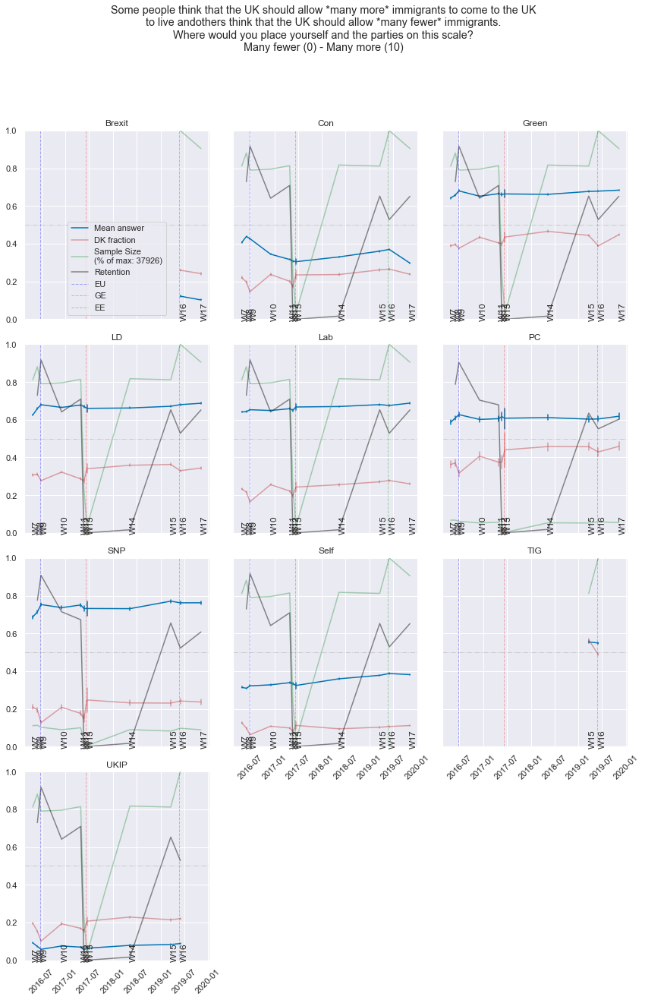

In [20]:
%%time
var_name = "immig"

title= "\n".join(["Some people think that the UK should allow *many more* immigrants to come to the UK",
                  "to live andothers think that the UK should allow *many fewer* immigrants.",
                  "Where would you place yourself and the parties on this scale?",
                  "Many fewer (0) - Many more (10)"])
specific_suffix_set = "(Self|Con|Lab|TIG|Brexit|Green|UKIP|PC|SNP|LD)"
col_name="party"
col_wrap=3
height = 4

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [21]:
BES_Panel.drop( match(BES_Panel,"immig(Self|Con|Lab|TIG|Brexit|Green|UKIP|PC|SNP|LD)(W12|W13)").index, axis=1, inplace=True)

Wall time: 8min 37s


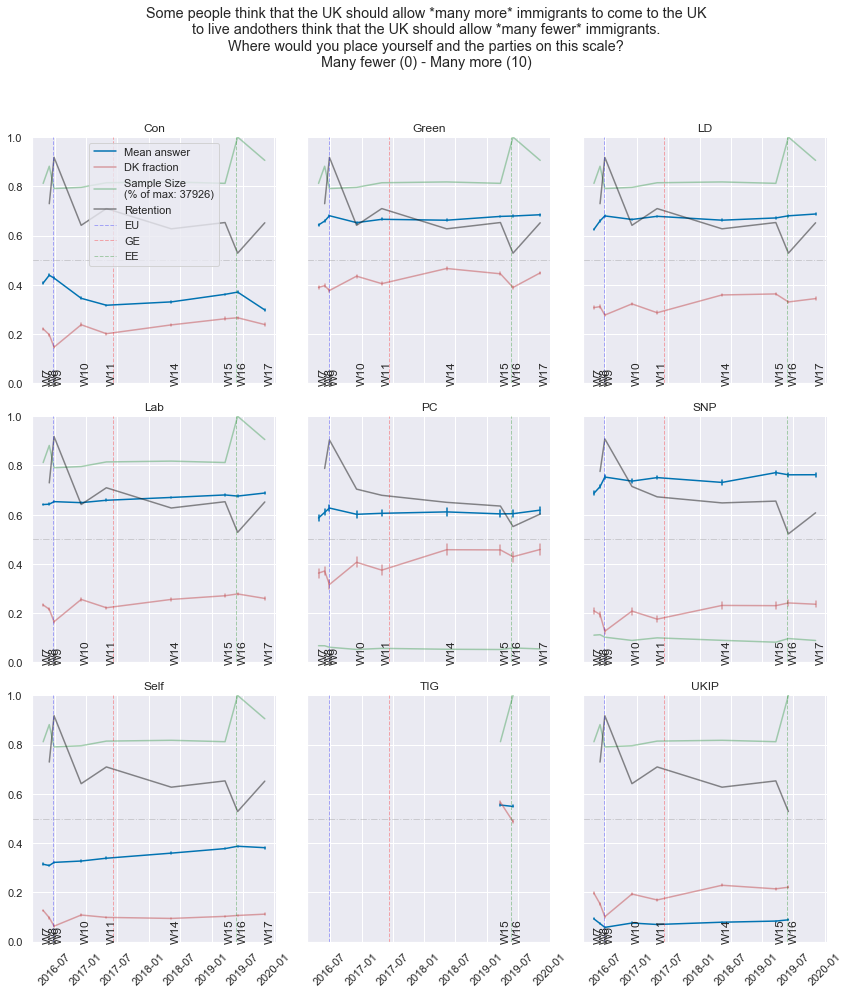

In [22]:
%%time
## now without those two waves


var_name = "immig"

title= "\n".join(["Some people think that the UK should allow *many more* immigrants to come to the UK",
                  "to live andothers think that the UK should allow *many fewer* immigrants.",
                  "Where would you place yourself and the parties on this scale?",
                  "Many fewer (0) - Many more (10)"])
specific_suffix_set = "(Self|Con|Lab|TIG|Green|UKIP|PC|SNP|LD)"
# drop Brexit because in only one wave
col_name="party"
col_wrap=3
height = 4

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [23]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"

suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["Think the UK should allow many more/fewer immigrants?"+"("+x+")" for x in suff_list]))

df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name, rolling_win_type=rolling_win_type)

Self


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-21 20:00:00,0.228628,24,1880,31.959509,0.356338,2016-04-21 10:00:00,2016-04-22 19:00:00
2018-05-13 09:00:00,0.172543,1880,2742,29.448317,0.368367,2018-05-12 20:00:00,2018-05-14 02:00:00


Con


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-06-04 17:00:00,0.158127,2005,3877,33.506282,0.350278,2019-06-03 12:00:00,2019-06-04 21:00:00


Lab


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


TIG


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-03-27 15:00:00,0.159201,295,835,58.844131,0.538837,2019-03-25 21:00:00,2019-03-28 10:00:00
2019-06-08 05:00:00,0.151791,514,835,34.631894,0.527860,2019-06-07 04:00:00,2019-06-08 15:00:00


Green


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 09:00:00,0.160861,118,2608,31.085700,0.666802,2016-04-21 16:00:00,2016-04-23 06:00:00
2017-04-29 00:00:00,0.153605,2053,2608,23.472055,0.648244,2017-04-28 13:00:00,2017-04-29 12:00:00


UKIP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


PC


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


SNP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


LD


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-06-25 04:00:00,0.179586,334,2640,100.868318,0.643534,2016-06-22 08:00:00,2016-06-28 08:00:00
2017-04-28 07:00:00,0.152076,2064,2640,60.512630,0.648556,2017-04-27 23:00:00,2017-04-30 11:00:00
2018-05-14 12:00:00,0.158633,2640,3112,31.818083,0.659812,2018-05-14 10:00:00,2018-05-15 17:00:00


Wall time: 2min 18s


# (3) studentsMore|euMore|asylumMore|familiesMore|noneuMore
    - consistent increase 8->13
    - 7-8 sharper but less consistent (flat for eu, bump for noneu, neg for families)

Wall time: 2min 8s


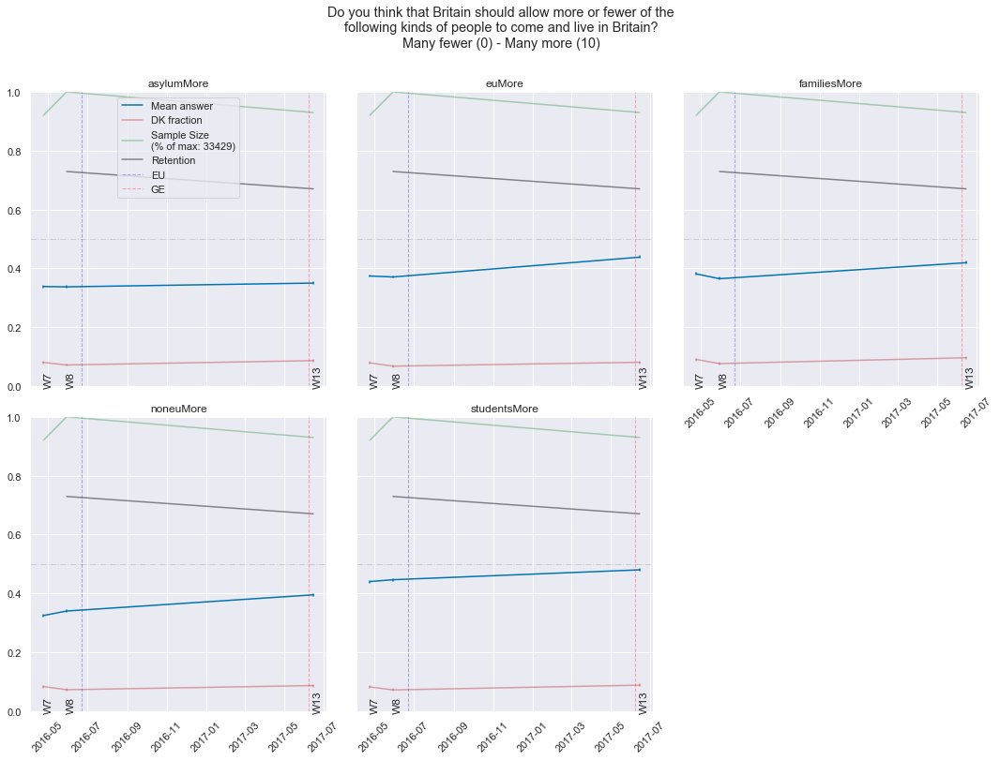

In [24]:
%%time
var_name = ""

title= "\n".join(["Do you think that Britain should allow more or fewer of the",
                  "following kinds of people to come and live in Britain?",
                  "Many fewer (0) - Many more (10)"])
specific_suffix_set = "(studentsMore|euMore|asylumMore|familiesMore|noneuMore)"
col_name="party"
col_wrap = 3
height   = 5

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [25]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["Britain should allow more/fewer of the following kinds of people?"+"("+x+")" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,prominence=prominence,width=width,rolling_win_type=rolling_win_type)
#, rolling_win_type="BES")

studentsMore


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 09:00:00,0.225086,70,1587,41.380027,0.466791,2016-04-21 09:00:00,2016-04-23 07:00:00


euMore


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 10:00:00,0.176626,29,978,34.834575,0.392781,2016-04-21 10:00:00,2016-04-22 21:00:00


asylumMore


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-21 19:00:00,0.255503,11,1330,38.626242,0.385392,2016-04-21 10:00:00,2016-04-23 06:00:00
2016-05-16 10:00:00,0.178187,567,1330,23.643754,0.339899,2016-05-15 12:00:00,2016-05-16 11:00:00


familiesMore


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 09:00:00,0.211441,24,760,39.253936,0.424932,2016-04-21 10:00:00,2016-04-23 06:00:00


noneuMore


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 04:00:00,0.201674,60,597,32.094843,0.370377,2016-04-21 11:00:00,2016-04-22 20:00:00


Wall time: 33.8 s


# (4) (labHandleImmig|govtHandleImmig)
Supremely dull

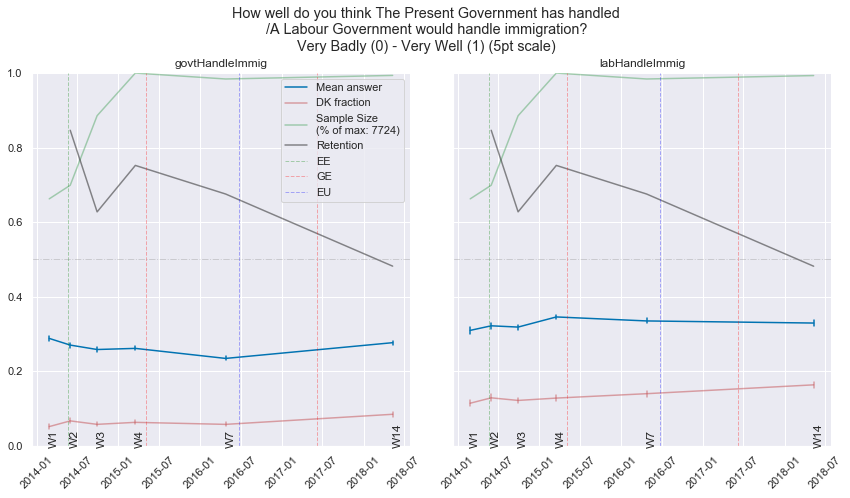

In [26]:
# %%time
var_name = ""

title= "\n".join(["How well do you think The Present Government has handled",
                  "/A Labour Government would handle immigration?",
                  "Very Badly (0) - Very Well (1) (5pt scale)"])
specific_suffix_set = "(labHandleImmig|govtHandleImmig)"
col_name="party"
col_wrap=2
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [27]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"

color_dict= {"govtHandleImmig":"blue","labHandleImmig":"red"}
title_dict= {"govtHandleImmig":"How well do you think The Present Government has handled immigration? (5pt scale)",
             "labHandleImmig":"How well do you think The Labour Party would handle immigration? (5pt scale)"}
prominence=.15
width=20
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict,var_name,
                                      prominence=prominence,width=width,rolling_win_type=rolling_win_type)

govtHandleImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


labHandleImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2015-03-28 13:00:00,0.213145,1215,1863,96.292895,0.357174,2015-03-25 18:00:00,2016-04-14 10:00:00
2016-05-02 16:00:00,0.170290,1863,2400,56.813390,0.339270,2016-04-30 07:00:00,2016-05-02 18:00:00
2018-05-13 19:00:00,0.159385,2400,2527,52.329563,0.334201,2018-05-12 08:00:00,2018-05-14 15:00:00


Wall time: 8.72 s


# (5) (immigrationLevel|immigContributeTake)
immigrationLevel in theory could be used to extend immigSelf (v similar question) - even though it's rather "meh"

immigContributeTake is a really important variable despite us only having it in two waves (and only a fraction of the cohort!)
partly because it's the *right* two waves - and partly because it just crops up a lot as a driver

Wall time: 25.8 s


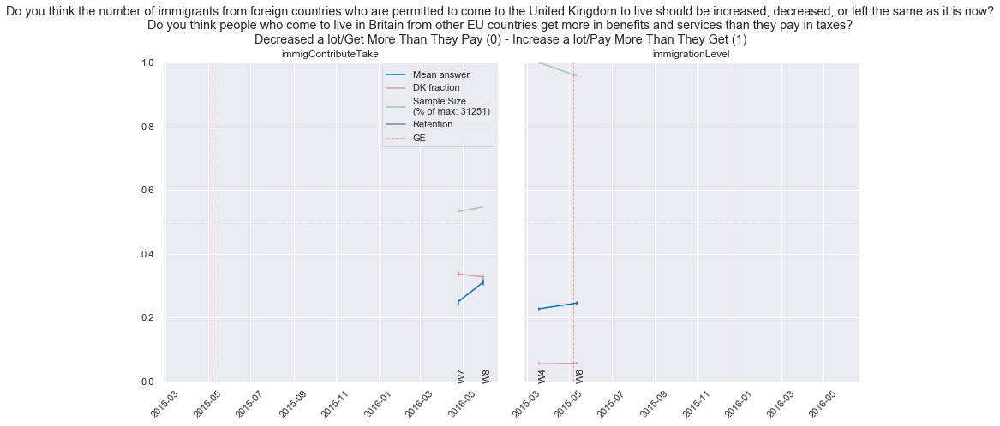

In [28]:
%%time
var_name = ""

title= "\n".join(["Do you think the number of immigrants from foreign countries who are permitted to come to the United Kingdom to live should be increased, decreased, or left the same as it is now?",
                  "Do you think people who come to live in Britain from other EU countries get more in benefits and services than they pay in taxes?",
                  "Decreased a lot/Get More Than They Pay (0) - Increase a lot/Pay More Than They Get (1)"
                  ])
specific_suffix_set = "(immigrationLevel|immigContributeTake)"
col_name="party"
col_wrap=2
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [29]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"

color_dict= {"immigrationLevel":"blue","immigContributeTake":"red"}
title_dict= {"immigrationLevel":"immigrationLevel (5pt scale)",
             "immigContributeTake":"immigContributeTake (7pt scale)"}
prominence=.15
width=20
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict,var_name,
                                      prominence=prominence,width=width, rolling_win_type=rolling_win_type)

immigrationLevel


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


immigContributeTake


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-21 22:00:00,0.191727,69,223,36.195963,0.258882,2016-04-21 08:00:00,2016-04-23 08:00:00
2016-05-01 19:00:00,0.161159,364,407,24.965937,0.268479,2016-05-01 09:00:00,2016-05-02 11:00:00
2016-06-02 11:00:00,0.275765,69,1246,45.770537,0.308466,2016-06-01 13:00:00,2016-06-03 16:00:00
2016-06-12 06:00:00,0.167128,1246,1284,20.940184,0.276311,2016-06-11 14:00:00,2016-06-12 12:00:00


Wall time: 8.22 s


# (6) (changeImmig|changeImmigLab|controlImmig)
changeImmig is a very long panel, decent coverage - sharp change around euref (shame it doesn't appear in W9)
changeImmigLab - dull!
controlImmig has a unfortunate problem
the W8 campaign sample would be perfect *but* it's not a full sample and the question shifts quite a lot
(there's three different versions, but probably big difference is between W8/W9+ - how much control does the UK have/would the UK have after ...)

Wall time: 4min 43s


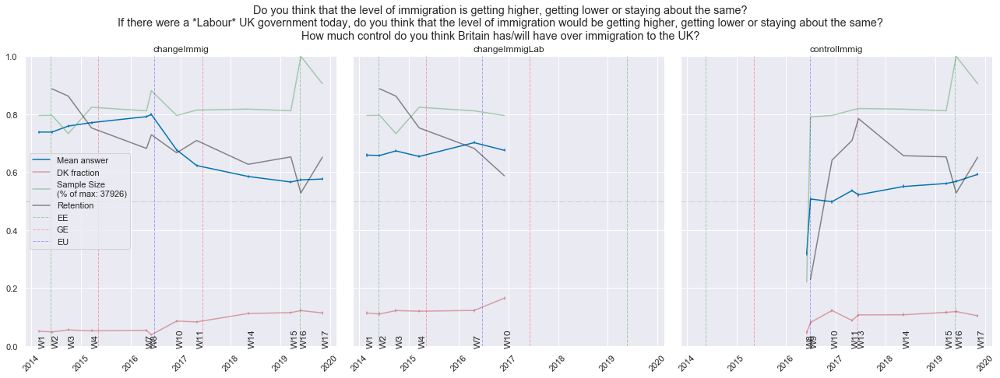

In [30]:
%%time
var_name = ""

title= "\n".join(["Do you think that the level of immigration is getting higher, getting lower or staying about the same?",
                  "If there were a *Labour* UK government today, do you think that the level of immigration would be getting higher, getting lower or staying about the same?",
                  "How much control do you think Britain has/will have over immigration to the UK?"
                  ])
specific_suffix_set = "(changeImmig|changeImmigLab|controlImmig)"
col_name="party"
col_wrap=3
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [31]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"

color_dict= {"changeImmig":"blue","changeImmigLab":"red","controlImmig":"purple"}
title_dict= {"changeImmig":"changeImmig (5pt scale)",
             "changeImmigLab":"changeImmigLab (5pt scale)",
             "controlImmig":"controlImmig (5pt scale)",}
prominence=.15
width=20
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict,var_name,
                                      prominence=prominence,width=width, rolling_win_type=rolling_win_type)

changeImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-02-28 23:00:00,0.185266,7,1746,78.367418,0.768851,2014-02-27 22:00:00,2014-03-03 07:00:00
2016-04-16 13:00:00,0.169609,1746,2485,86.317386,0.772973,2016-04-15 03:00:00,2016-04-18 17:00:00
2016-05-27 15:00:00,0.237461,1746,5193,677.740197,0.753128,2016-05-20 13:00:00,2016-06-18 08:00:00
2019-06-11 07:00:00,0.155025,5193,5956,34.034829,0.594675,2019-06-10 22:00:00,2019-06-12 08:00:00


changeImmigLab


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


controlImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-06-25 04:00:00,0.202705,606,1115,52.075536,0.494077,2016-06-24 16:00:00,2016-06-26 20:00:00


Wall time: 1min 5s


In [32]:
# I'll have to check that glitch in Retention out later

# (5) (immigrantsWelfareState|effectsEUImmigration|euPriorityBalance)
immigrantsWelfareState - this variable is super important (long profile, good sample size and it crops up in lots of regressions)


effectsEUImmigration - "Do you think the following would be higher, lower or about the same if the UK leaves the European Union?"
    important since this is an actual explicit *cause and effect in relation to the UK leaving the EU*
    (and not, say, a Con government being elected/perception of UK politicians)
    
euPriorityBalance - reflects the slow but continuous positive shift in UK attitudes to Freedom of Movement

Wall time: 5min 17s


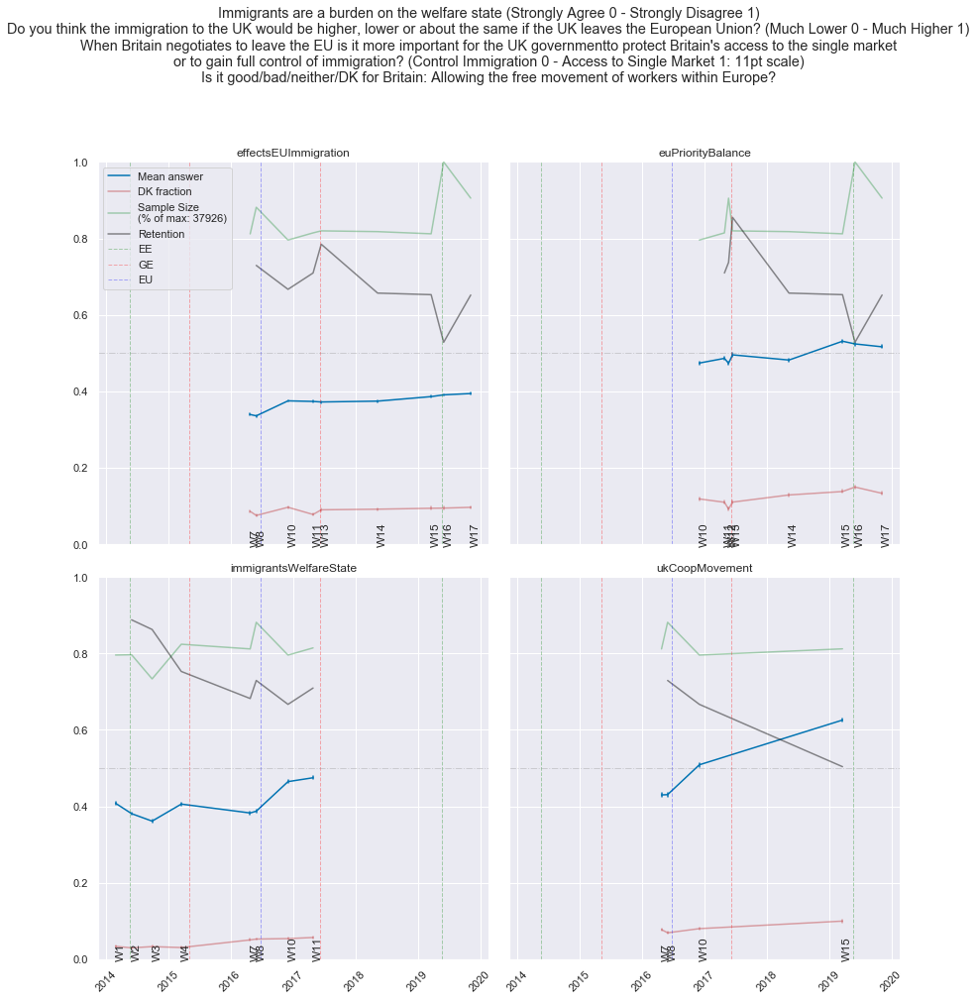

In [33]:
%%time
var_name = ""

title= "\n".join(["Immigrants are a burden on the welfare state (Strongly Agree 0 - Strongly Disagree 1)",
                  "Do you think the immigration to the UK would be higher, lower or about the same if the UK leaves the European Union? (Much Lower 0 - Much Higher 1)",
                  "When Britain negotiates to leave the EU is it more important for the UK governmentto protect Britain's access to the single market",
                  "or to gain full control of immigration? (Control Immigration 0 - Access to Single Market 1: 11pt scale)",
                  "Is it good/bad/neither/DK for Britain: Allowing the free movement of workers within Europe?"])
specific_suffix_set = "(immigrantsWelfareState|effectsEUImmigration|euPriorityBalance|ukCoopMovement)"
col_name="party"
col_wrap=2
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [34]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"

color_dict= {"immigrantsWelfareState":"blue","effectsEUImmigration":"red","euPriorityBalance":"purple","ukCoopMovement":"orange"}
title_dict= {"immigrantsWelfareState":"Immigrants are a burden on the welfare state (5pt scale)",
             "effectsEUImmigration":"Would immigration be higher, lower or about the same if the UK leaves the EU? (5pt scale)",
             "euPriorityBalance":"Brexit priority: access to single market versus controlling immigration? (11pt scale)",
             "ukCoopMovement":"IS allowing the free movement of workers within Europe Good/Bad/Neither (3pt scale)",}
prominence=.15
width=20
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict,var_name,
                                      prominence=prominence,width=width, rolling_win_type=rolling_win_type)

immigrantsWelfareState


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-03-05 16:00:00,0.199007,244,1670,20.155623,0.409715,2014-03-05 09:00:00,2014-03-06 06:00:00
2014-06-23 18:00:00,0.188634,591,1670,74.073985,0.393170,2014-06-18 07:00:00,2014-06-23 23:00:00
2014-10-13 17:00:00,0.258095,1670,2261,141.285743,0.425386,2014-10-12 12:00:00,2015-03-09 16:00:00
2015-03-22 23:00:00,0.154916,1957,2261,21.085903,0.422756,2015-03-22 20:00:00,2015-03-23 17:00:00
2016-04-22 08:00:00,0.277997,1670,3091,32.807845,0.431683,2016-04-21 10:00:00,2016-04-22 20:00:00
2016-12-09 09:00:00,0.152846,4196,4342,44.146691,0.466507,2016-12-08 21:00:00,2017-04-24 11:00:00


effectsEUImmigration


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


euPriorityBalance


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2017-05-23 10:00:00,0.153313,997,1190,20.442390,0.467847,2017-05-22 13:00:00,2017-05-23 11:00:00
2019-03-26 11:00:00,0.217192,77,3003,21.470079,0.533835,2019-03-25 15:00:00,2019-03-26 13:00:00


ukCoopMovement


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-22 14:00:00,0.320149,24,1213,39.312360,0.487112,2016-04-21 10:00:00,2016-04-23 07:00:00
2016-05-16 00:00:00,0.157331,617,759,23.251118,0.430298,2016-05-15 15:00:00,2016-05-16 14:00:00
2016-06-02 11:00:00,0.153620,1019,1213,40.219439,0.425321,2016-06-01 16:00:00,2016-06-03 08:00:00
2019-03-14 21:00:00,0.178446,24,2155,20.138440,0.617730,2019-03-14 12:00:00,2019-03-15 10:00:00
2019-03-24 10:00:00,0.182168,24,2345,59.429098,0.651053,2019-03-23 20:00:00,2019-03-26 08:00:00


Wall time: 1min 11s


# (6) responsibleImmig(Conservatives|LibDems|Labour|ScottishGovt|WelshGovt|None|DontKnow)

interesting, because it directly follows from changeImmig questions ...
... and yet the trends are also deeply boring

Wall time: 2min 27s


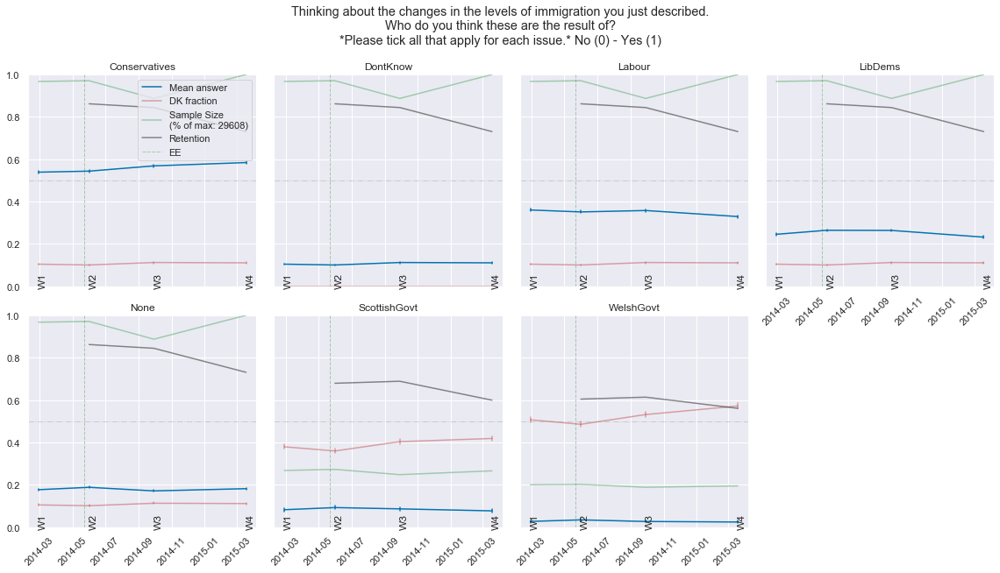

In [35]:
%%time
var_name = "responsibleImmig"

title= "\n".join(["Thinking about the changes in the levels of immigration you just described.",
                  "Who do you think these are the result of?",
                  "*Please tick all that apply for each issue.* No (0) - Yes (1)"])
specific_suffix_set = "(Conservatives|LibDems|Labour|ScottishGovt|WelshGovt|None|DontKnow)"
col_name="party"
col_wrap=4
height = 4

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [36]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["Who is responsible for the changes in lvls of imm. you just described?"+"("+x+")" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,prominence=prominence,width=width,
                                      rolling_win_type=rolling_win_type)

Conservatives


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-02-23 19:00:00,0.190285,7,183,22.733176,0.540107,2014-02-23 17:00:00,2014-02-24 16:00:00
2014-06-15 21:00:00,0.204959,604,1078,86.777178,0.545404,2014-06-13 07:00:00,2014-06-18 08:00:00
2014-09-29 02:00:00,0.256801,1098,1660,20.574075,0.560393,2014-09-28 12:00:00,2014-09-29 09:00:00
2015-03-17 02:00:00,0.159889,1936,2013,26.943904,0.568828,2015-03-16 12:00:00,2015-03-17 15:00:00


LibDems


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-02-28 22:00:00,0.177080,62,261,24.123491,0.250765,2014-02-27 22:00:00,2014-02-28 23:00:00
2014-06-07 14:00:00,0.156526,750,1089,35.931208,0.266016,2014-06-06 07:00:00,2014-06-08 02:00:00
2015-03-16 14:00:00,0.167925,1882,1994,21.060636,0.223404,2015-03-15 22:00:00,2015-03-16 19:00:00


Labour


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-03-01 00:00:00,0.200386,98,884,35.362081,0.374200,2014-02-28 21:00:00,2014-03-02 09:00:00
2014-06-13 18:00:00,0.158587,884,1073,46.690022,0.330481,2014-06-12 19:00:00,2014-06-15 06:00:00


ScottishGovt


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-06-25 09:00:00,0.16697,260,1386,24.449686,0.101362,2014-06-24 10:00:00,2014-06-25 12:00:00


WelshGovt


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


None


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-10-13 16:00:00,0.23342,244,2131,66.470486,0.212212,2014-10-12 10:00:00,2014-10-15 08:00:00


DontKnow


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-02-24 22:00:00,0.174837,74,465,22.849990,0.134496,2014-02-24 18:00:00,2014-02-25 17:00:00
2014-06-19 21:00:00,0.180862,465,1092,124.058352,0.133818,2014-06-14 16:00:00,2014-06-23 16:00:00
2014-10-14 22:00:00,0.239006,465,1931,105.572973,0.155336,2014-10-13 13:00:00,2014-10-28 21:00:00


Wall time: 46.4 s


# (7) achieveReduceImmig(Brexit|Con|Grn|LD|Lab|None|PC|SNP|TIG|UKIP)
Wow - charts for LD/Green are not broken - there are some Yes's - just very few
Con pattern interesting - the way it ever-so-briefly kisses UKIP before collapsing back into the GE
UKIP is trending down even before the euref

Wall time: 12min 25s


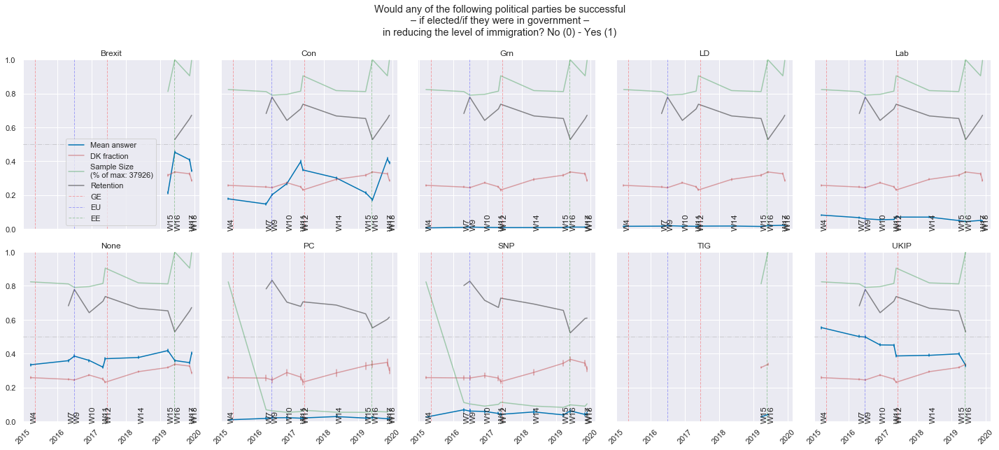

In [37]:
%%time
var_name = "achieveReduceImmig"

title= "\n".join(["Would any of the following political parties be successful",
                  " – if elected/if they were in government – ",
                  "in reducing the level of immigration? No (0) - Yes (1)"])
specific_suffix_set = "(Brexit|Con|Grn|LD|Lab|None|PC|SNP|TIG|UKIP)"
col_name="party"
col_wrap=5
height = 4

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [38]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["Would this party be succ in reducing imm if elected/in gov?"+"("+x+")" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,prominence=prominence,width=width,
                                      rolling_win_type=rolling_win_type)

Brexit


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Con


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-04-21 16:00:00,0.202767,598,882,33.894691,0.173142,2016-04-21 06:00:00,2016-04-22 17:00:00
2016-11-29 16:00:00,0.203628,598,1378,20.462850,0.262763,2016-11-28 21:00:00,2016-11-29 17:00:00
2017-04-27 07:00:00,0.430374,598,3875,24.838885,0.294977,2017-04-26 22:00:00,2017-04-27 22:00:00
2017-05-28 09:00:00,0.219084,2285,2777,29.378107,0.321704,2017-05-27 08:00:00,2017-05-28 14:00:00
2019-11-04 19:00:00,0.185657,3987,4052,25.283577,0.390335,2019-11-04 05:00:00,2019-11-05 06:00:00


Grn


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


LD


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Lab


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


None


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-03-28 10:00:00,0.155413,3391,3611,31.862397,0.421184,2019-03-27 23:00:00,2019-03-29 11:00:00
2019-06-05 17:00:00,0.255085,3611,3920,22.397166,0.376410,2019-06-05 14:00:00,2019-06-06 12:00:00
2019-06-10 21:00:00,0.189173,3806,3920,27.117110,0.341627,2019-06-09 20:00:00,2019-06-10 23:00:00
2019-06-14 11:00:00,0.250957,3920,4148,24.885949,0.377377,2019-06-13 13:00:00,2019-11-01 14:00:00
2019-12-05 19:00:00,0.193738,4689,4758,20.604327,0.401844,2019-12-05 12:00:00,2019-12-06 09:00:00


PC


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


SNP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


TIG


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


UKIP


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2015-03-20 13:00:00,0.160514,225,360,20.313633,0.551015,2015-03-19 18:00:00,2015-03-20 14:00:00
2016-04-16 10:00:00,0.170931,522,629,22.762946,0.477011,2016-04-16 07:00:00,2016-04-17 06:00:00
2016-04-22 17:00:00,0.265715,654,748,44.560537,0.487524,2016-04-21 05:00:00,2016-04-23 07:00:00
2016-05-02 18:00:00,0.310596,748,1403,23.274059,0.499951,2016-05-02 11:00:00,2016-05-03 10:00:00
2016-11-28 15:00:00,0.212138,1253,1403,21.272558,0.431656,2016-11-27 20:00:00,2016-11-28 17:00:00
2018-05-13 09:00:00,0.288355,1861,3739,20.171655,0.378495,2018-05-12 22:00:00,2018-05-13 18:00:00


Wall time: 3min 3s


# (8) (conPriorities_immig|labPriorities_immig|ldPriorities_immig|ukipPriorities_immig)

low sample size even at peak
bump around 2015 GE

Wall time: 1min 14s


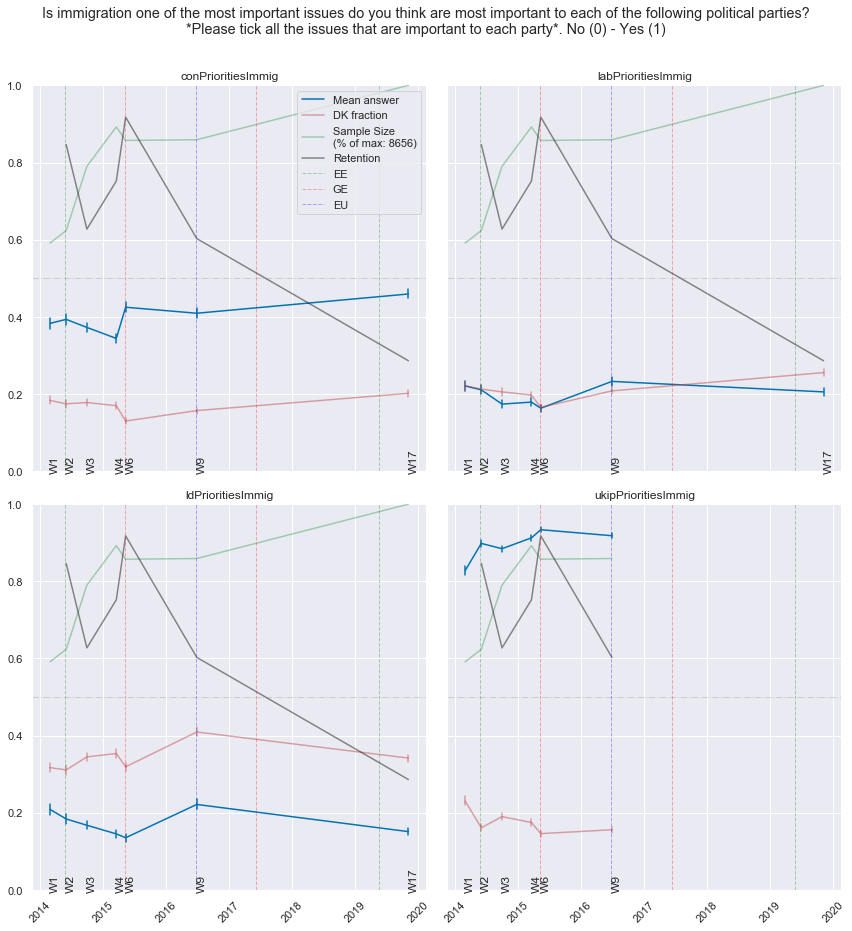

In [39]:
%%time
var_name = ""

title= "\n".join(["Is immigration one of the most important issues do you think are most important to each of the following political parties?",
                  "*Please tick all the issues that are important to each party*. No (0) - Yes (1)"])
specific_suffix_set = "(conPrioritiesImmig|labPrioritiesImmig|ldPrioritiesImmig|ukipPrioritiesImmig)"
col_name="party"
col_wrap=2
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [40]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["Is immigration one of the most important issues for this party?"+"("+x+")" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,prominence=prominence,width=width,
                                     rolling_win_type=rolling_win_type)
#, rolling_win_type="BES")

conPrioritiesImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-02-23 08:00:00,0.164065,58,124,23.747221,0.365412,2014-02-22 14:00:00,2014-02-23 13:00:00
2014-03-05 12:00:00,0.225054,124,448,20.460389,0.385687,2014-03-04 21:00:00,2014-03-05 17:00:00
2014-06-24 08:00:00,0.256580,124,1694,55.284404,0.388672,2014-06-23 18:00:00,2014-09-19 15:00:00
2014-09-25 10:00:00,0.157249,866,923,20.413067,0.363968,2014-09-24 19:00:00,2014-09-25 17:00:00
2014-10-03 11:00:00,0.150705,923,1191,35.984171,0.371775,2014-10-02 09:00:00,2014-10-04 05:00:00
2014-10-14 11:00:00,0.173396,923,1363,106.849209,0.369923,2014-10-12 09:00:00,2015-03-09 15:00:00
2016-06-30 21:00:00,0.223491,2144,2284,41.235409,0.438604,2016-06-30 07:00:00,2016-07-02 09:00:00
2019-11-01 17:00:00,0.270349,1694,2377,30.162247,0.430695,2016-07-04 08:00:00,2019-11-02 08:00:00


labPrioritiesImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-06-24 08:00:00,0.190397,238,1283,24.071295,0.220389,2014-06-24 05:00:00,2014-06-25 06:00:00
2016-06-29 11:00:00,0.194946,1283,2479,28.633099,0.208967,2016-06-28 12:00:00,2016-06-29 18:00:00


ldPrioritiesImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2014-03-02 01:00:00,0.150139,137,447,43.498775,0.193379,2014-02-28 20:00:00,2014-03-03 02:00:00
2014-06-04 12:00:00,0.189816,447,1785,176.601186,0.192153,2014-06-01 10:00:00,2014-06-22 04:00:00
2014-09-26 15:00:00,0.161209,841,1516,40.246224,0.163274,2014-09-25 21:00:00,2014-09-27 18:00:00


ukipPrioritiesImmig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Wall time: 19.1 s


# (9) dealPriority(MarketAccess|NIUKBorder|NIEireBorder|TradeDeal|RedTape|Immig)
okay - no signficant changes W15->W16
only thing of note - how low "control immigration" (or, indeed, RedTape) stands relative to the other priorities
(suspect this is largely because of Leave/Remain split)

Wall time: 1min 52s


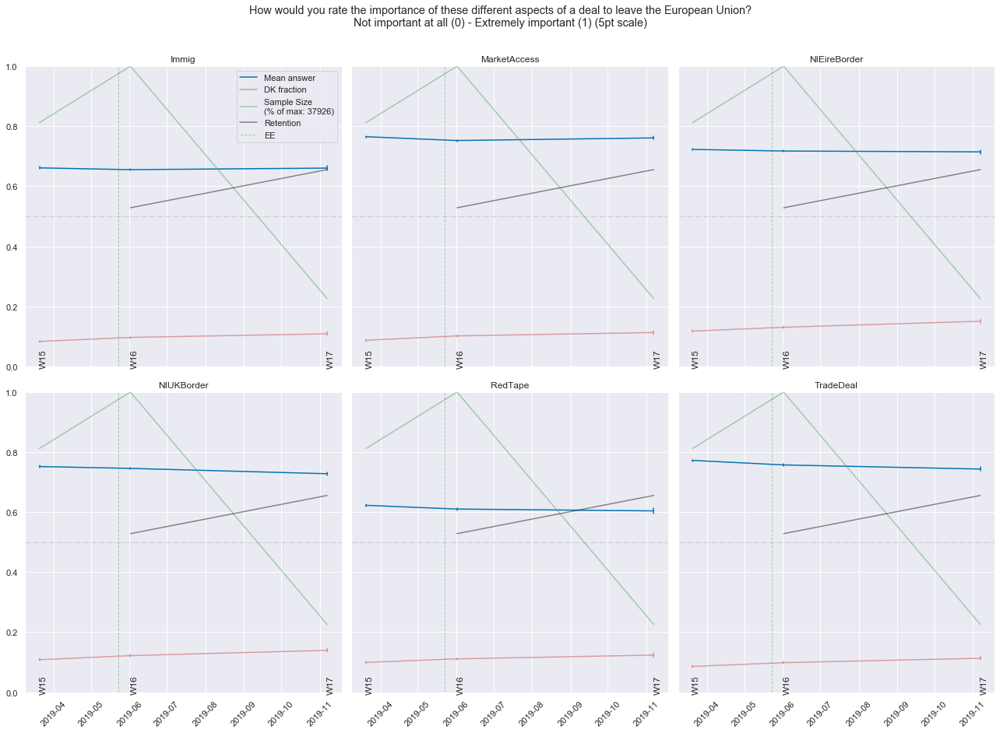

In [41]:
%%time
var_name = "dealPriority"

title= "\n".join(["How would you rate the importance of these different aspects of a deal to leave the European Union?",
                  "Not important at all (0) - Extremely important (1) (5pt scale)"])
specific_suffix_set = "(MarketAccess|NIUKBorder|NIEireBorder|TradeDeal|RedTape|Immig)"
col_name="party"
col_wrap=3
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [42]:
# %%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["How would you rate the imp. of diff. aspects of a Deal?"+"("+x+")" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,prominence=prominence,width=width,
                                      rolling_win_type=rolling_win_type)

MarketAccess


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


NIUKBorder


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


NIEireBorder


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


TradeDeal


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


RedTape


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2019-03-17 15:00:00,0.177134,65,319,56.852419,0.614465,2019-03-16 12:00:00,2019-03-18 20:00:00
2019-03-19 17:00:00,0.168422,166,319,31.778010,0.611716,2019-03-19 12:00:00,2019-03-20 20:00:00
2019-05-24 10:00:00,0.182288,319,529,23.743307,0.592142,2019-03-28 18:00:00,2019-05-24 12:00:00


Immig


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


In [43]:
# date, dealPriority_wts, dealPriority_dk       

In [44]:
# %debug

# (9) negotiationSpecifics(ContinuePayingMoney|AcceptingFoM|AcceptingEUReg|Nothing)
Feels like there's one transition W9 -> W10 where a chunk of people go from "no concessions necessary" -> "some concessions necessary"

Then one more transition W14 -> W15 where another chunk of people reconsider some of those concessions (FoM/Paying money)
Notable that AcceptingEUReg doesn't waver.
Something to do with perception of weakness of May/strength of ERG as perceived by people reading tabloids?

Wall time: 2min 48s


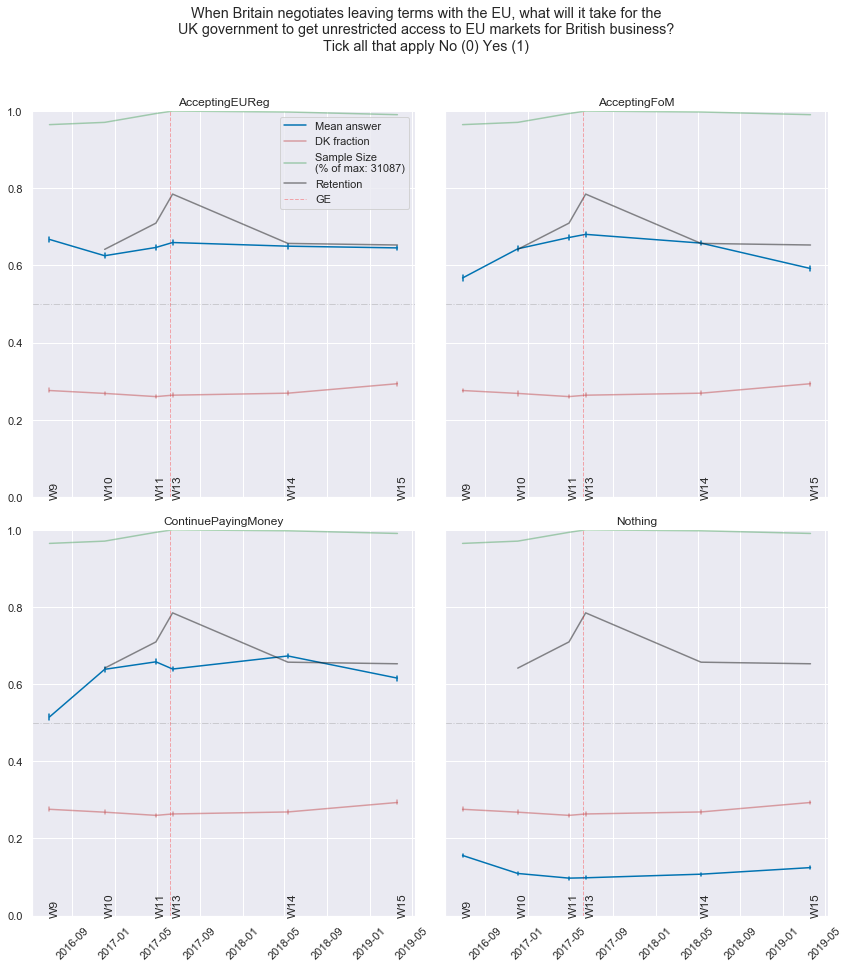

In [45]:
%%time
var_name = "negotiationSpecifics"

title= "\n".join(["When Britain negotiates leaving terms with the EU, what will it take for the",
                  "UK government to get unrestricted access to EU markets for British business?",
                  "Tick all that apply No (0) Yes (1)"])
specific_suffix_set = "(ContinuePayingMoney|AcceptingFoM|AcceptingEUReg|Nothing)"
col_name="party"
col_wrap=2
height = 6

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [46]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"


suff_list = specific_suffix_set.replace(")","").replace("(","").split("|")
color_dict = dict(zip(suff_list,colour_list))
title_dict = dict(zip(suff_list,["What must the UK give to get Single Market access?"+"("+x+")" for x in suff_list]))

prominence=.15
width=20
                                 
df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name,prominence=prominence,width=width,
                                      rolling_win_type=rolling_win_type)

ContinuePayingMoney


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-12-02 00:00:00,0.233378,42,510,39.805342,0.640089,2016-12-01 19:00:00,2016-12-03 10:00:00
2016-12-09 09:00:00,0.315087,42,1051,32.848744,0.641860,2016-12-08 06:00:00,2016-12-09 15:00:00
2018-05-19 09:00:00,0.243133,1240,1683,44.933262,0.645455,2018-05-17 17:00:00,2018-05-19 14:00:00


AcceptingFoM


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,
2016-06-29 18:00:00,0.343190,24,1787,97.973490,0.628473,2016-06-29 15:00:00,2016-07-03 20:00:00
2017-06-23 09:00:00,0.269218,509,1787,58.663748,0.639600,2017-06-21 18:00:00,2018-05-04 15:00:00
2018-05-14 17:00:00,0.164312,1252,1429,31.539177,0.661175,2018-05-13 15:00:00,2018-05-14 22:00:00
2018-05-20 08:00:00,0.170420,1535,1581,30.833951,0.647493,2018-05-19 21:00:00,2018-05-21 09:00:00
2019-03-19 11:00:00,0.184512,1679,1787,21.242677,0.570863,2019-03-18 18:00:00,2019-03-19 15:00:00


AcceptingEUReg


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Nothing


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Wall time: 56.2 s


# (9) benefitsToMigrants
Thinking of people coming to live in Great Britain,
when do you think they should obtain the same rights to social benefits and services as citizens already living here?

wow - superflat
does this period cover the time when Cameron was trying to negotiate this?
Even afterwards, it seems weird for it to be so very very flat

Wall time: 28.8 s


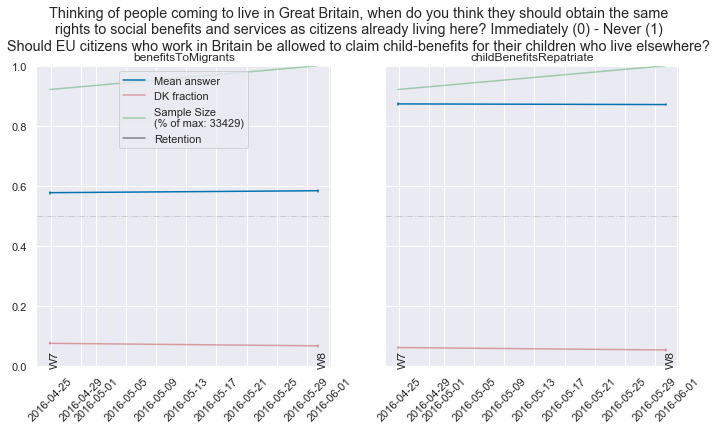

In [47]:
%%time
var_name = ""

title= "\n".join(["Thinking of people coming to live in Great Britain, when do you think they should obtain the same",
                  "rights to social benefits and services as citizens already living here? Immediately (0) - Never (1)",
                  "Should EU citizens who work in Britain be allowed to claim child-benefits for their children who live elsewhere?"
                  ])
specific_suffix_set = "(benefitsToMigrants|childBenefitsRepatriate)"
col_name="party"
col_wrap=2
height = 5

flat_df_num = plot_time_series(var_name=var_name,specific_suffix_set=specific_suffix_set,title=title,col_name="party",
                               col_wrap=col_wrap,treatment="immig_timeseries",max_wave=max_wave,use_BES_weights=use_BES_weights)

In [48]:
%%time

y_axis_label = "circles=daily-mean/line=moving average"
x_axis_label = "Response Date"

color_dict= {"benefitsToMigrants":"blue", "childBenefitsRepatriate":"red"}
title_dict= {"benefitsToMigrants":"When should immigrants get access to UK benefits?",
             "childBenefitsRepatriate":"Should EU citi working in UK be allowed to claim for children outside UK?"}

df,df_rolling = bokeh_explorer_charts(x_axis_label,y_axis_label,color_dict,title_dict, var_name, rolling_win_type=rolling_win_type)

benefitsToMigrants


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


childBenefitsRepatriate


,prominences,left_bases,right_bases,widths,width_heights,start,stop
date,,,,,,,


Wall time: 12.6 s


In [49]:
BES_Panel["benefitsToMigrantsW8"].value_counts()

After they have worked and paid taxes for at least four years    15589
After they become a British citizen                               7792
Never                                                             3959
After living in GB for a year                                     2397
Don't know                                                        2276
Immediately on arrival                                            1416
Name: benefitsToMigrantsW8, dtype: int64

In [50]:
#
# 9999, Very cold, Very warm, Don't know

# "warm(Denmark|France|Poland|Romania|Greece|Spain|UK|White|Asian|Black|Eastern|Syrians|Indians|Muslim|Jewish|Christian|Atheist|WC|MC|Benefits|Poor|Rich)


list( search(BES_Panel,"warm").index )

['warmDenmarkW7',
 'warmFranceW7',
 'warmPolandW7',
 'warmRomaniaW7',
 'warmGreeceW7',
 'warmSpainW7',
 'warmUKW7',
 'warmWhiteW11',
 'warmAsianW11',
 'warmBlackW11',
 'warmEasternW11',
 'warmSyriansW11',
 'warmIndianW11',
 'warmWCW11',
 'warmMCW11',
 'warmBenefitsW11',
 'warmPoorW11',
 'warmRichW11',
 'warmMuslimW11',
 'warmChristianW11',
 'warmJewishW11',
 'warmAtheistW11',
 'warmMuslimW15',
 'warmChristianW15',
 'warmJewishW15',
 'warmAtheistW15']

In [51]:

search(BES_Panel,"(region|london|wb|mc|wc|local|rich|poor|self)EconW\d+")

regionEconW11    30887
londonEconW11    27685
wbEconW11        30887
mcEconW11        30887
wcEconW11        30887
localEconW11     30887
selfEconW11      30887
regionEconW15     6974
londonEconW15     6124
wbEconW15         6974
mcEconW15         6974
wcEconW15         6974
localEconW15      6974
richEconW15       6974
poorEconW15       6974
selfEconW15       6974
dtype: int64